In [48]:
from sklearn.cluster import KMeans
from sklearn.metrics import normalized_mutual_info_score
from itertools import combinations
import pandas as pd
import os
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import numpy as np
from scipy.spatial.distance import cdist
import networkx as nx
from sklearn.metrics import silhouette_score
import seaborn as sns

In [49]:
filelocation_TET = 'NDT_all_12thDec_uncleaned.csv'
feelings = ['MetaAwareness','Presence','PhysicalEffort','MentalEffort','Boredom', 'Receptivity', 'EmotionalIntensity', 'Clarity', 'Release', 'Bliss', 'Embodiment', 'Insightfulness', 'Anxiety', 'SpiritualExperience']
header = "Week"
no_dimensions = 2
colours = {0:'red',1:'green',2:'blue',3:'orange',4:'pink',5:'yellow'}
colours_list = ['red','green','blue','orange','pink','yellow']
n_clust = 3
headers = {'Subject':0, 'Week':1, 'Session':2}
lcm = 332640
n_rep = 1

In [50]:
class csv_splitter:

    def __init__(self,excel_file_name):
        self.excel_file_location = f'c:\\Users\\hugma\\diss\\{excel_file_name}'
        self.dataframes = None
    def read_excel(self):
        try:
            df_excel_file_name = pd.read_csv(self.excel_file_location)
            return df_excel_file_name
        except Exception as e:
            print(f"error reading Excel file: {e}")
    def split_by_header(self,df_excel_file_name, heading):
        if heading not in df_excel_file_name.columns:
            print(f"Error: '{heading}' not found in DataFrame columns.")
            return None
        heading_values = df_excel_file_name[heading].unique()
        split_df = {value: df_excel_file_name[df_excel_file_name[heading] == value] for value in heading_values}
        split_df_array = [[key, value] for key, value in split_df.items()]
        return split_df, split_df_array

In [51]:
class principal_component_finder:

    def __init__(self,csv_file, feelings,no_dimensions):
        self.csv_file_TET = csv_file[feelings]
        corr_matrix = self.csv_file_TET.corr()
        pca = PCA(n_components=no_dimensions)
        self.principal_components=pca.fit_transform(corr_matrix)
        self.explained_variance_ratio = pca.explained_variance_ratio_
    def PCA_TOT(self):
        df_TET_feelings_prin = self.csv_file_TET.dot(self.principal_components)
        for i in range(0,self.principal_components.shape[1]):
            y_values = []
            for j in range(0,len(feelings)):
                y_values.append(self.principal_components[j][i])
            plt.figure()
            plt.bar(feelings,y_values)
            plt.title(f'principal componant {i+1}')
            plt.xticks(rotation=45, ha='right')
        plt.figure()
        plt.scatter(df_TET_feelings_prin[0],df_TET_feelings_prin[1], s=0.5)
        plt.xlabel('principal componant 1 (bored/effort)')
        plt.ylabel('principal componant 2 (calm)')
        plt.xlim(-6,6)
        plt.ylim(-1,2)
        
        return self.principal_components, self.explained_variance_ratio, df_TET_feelings_prin
    def PCA_split(self,split_df_array):
        split_df_array_TET = [[split_df_array[i][0],split_df_array[i][1][feelings]] for i in range(0,len(split_df_array))]
        split_csv_TET = {split_df_array_TET[i][0]: split_df_array_TET[i][1] for i in range(0,len(split_df_array))}
        df_TET_feelings_prin_dict = {name: split_csv_TET[name].dot(self.principal_components) for name in split_csv_TET.keys()}
        for key,value in df_TET_feelings_prin_dict.items():
            plt.figure()
            plt.scatter(value[0],value[1],s=0.5)
            plt.title(key)
            plt.xlabel('principal componant 1 (bored/effort)')
            plt.ylabel('principal componant 2 (calm)')
            plt.xlim(-6,6)
            plt.ylim(-1,2)
            plt.show()
        return df_TET_feelings_prin_dict

In [52]:
csv_splitter_instance = csv_splitter(filelocation_TET)
df_csv_file = csv_splitter_instance.read_excel()
split_df, split_csv_array = csv_splitter_instance.split_by_header(df_csv_file,header)

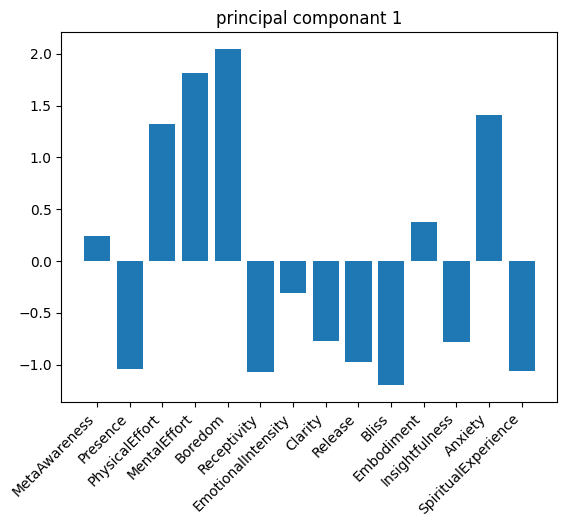

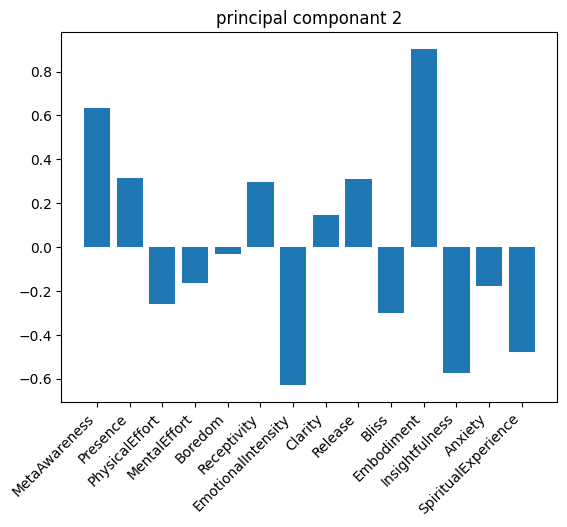

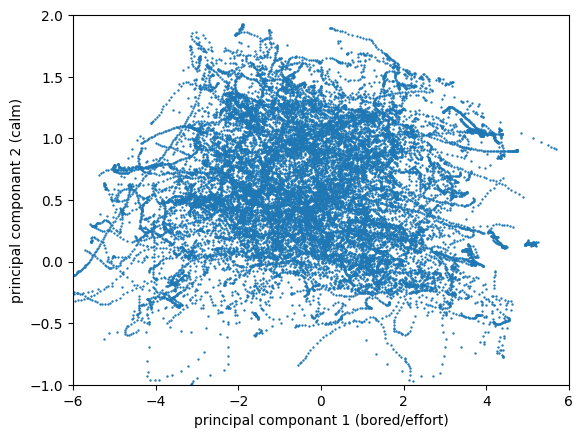

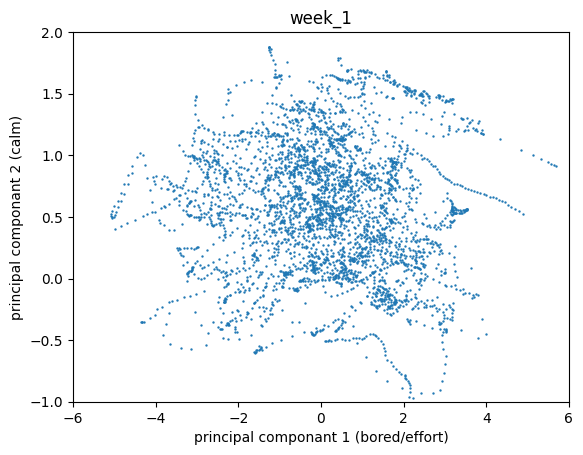

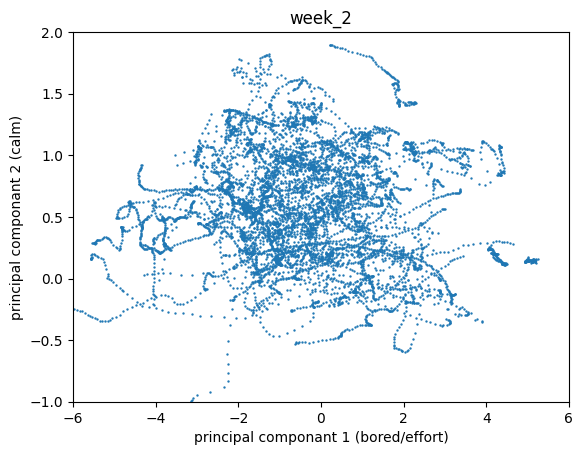

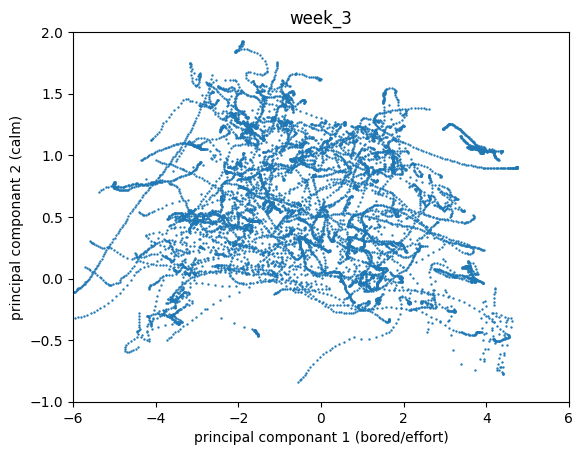

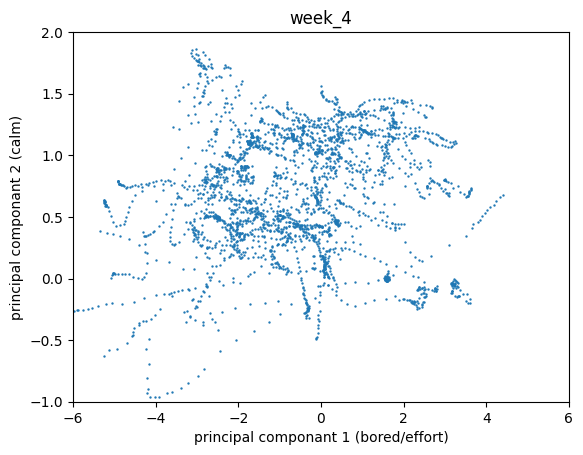

In [53]:
principal_component_finder_instance = principal_component_finder(df_csv_file,feelings,no_dimensions)
principal_components, explained_variance_ratio, df_TET_feelings_prin = principal_component_finder_instance.PCA_TOT()
df_TET_feelings_prin_dict = principal_component_finder_instance.PCA_split(split_csv_array)

In [54]:
for feeling in feelings: 
 
    df_csv_file[f'{feeling}_diff'] = -df_csv_file[feeling].diff(-1)

In [55]:
split_dict = {}
for (subject, week, session), group in df_csv_file.groupby(['Subject', 'Week', 'Session']):
    split_dict[(subject, week, session)] = group.copy()

In [56]:
differences_array = pd.concat([df[:-1] for df in split_dict.values()])
numbers = []
for i in range(differences_array.shape[0]):
    numbers.append(i)
   
differences_array_MI = differences_array.copy()
differences_array_MI['number'] = numbers

In [57]:
wcss_best = 10000000
labels_fin = []
cluster_centres_fin = []
for i in range(0,1000):
    kmeans = KMeans(4)
    kmeans.fit(differences_array.iloc[:,-14:])
    labels = kmeans.labels_
    cluster_centres = kmeans.cluster_centers_
    wcss = kmeans.inertia_
    if wcss< wcss_best:
        wcss_best = wcss
        labels_fin = labels
        cluster_centres_fin = cluster_centres
differences_array_MI['labels unnormalised vectors'] = labels_fin


In [58]:
point_colours = []
for i in labels:
    point_colours.append(colours[i])

In [59]:
magnitudes = np.linalg.norm(differences_array.iloc[:,-14:], axis=1)

# Replace any zeros with ones to avoid division by zero
magnitudes[magnitudes == 0] = 1

# Normalize each row to have the same magnitude
normalized_df = differences_array.iloc[:,-14:].div(magnitudes, axis=0)

In [60]:
wcss_best = 10000000
labels_norm_fin = []
cluster_centres_norm_fin = []
for i in range(0,1000):
    kmeans = KMeans(4)
    kmeans.fit(normalized_df)
    labels_norm = kmeans.labels_
    cluster_centres_norm = kmeans.cluster_centers_
    wcss = kmeans.inertia_
    if wcss< wcss_best:
        wcss_best = wcss
        labels_norm_fin = labels_norm
        cluster_centres_norm_fin = cluster_centres_norm
differences_array_MI['labels normalised vectors'] = labels_norm_fin

In [61]:
point_colours_norm = []
for i in labels_norm_fin:
    point_colours_norm.append(colours[i])

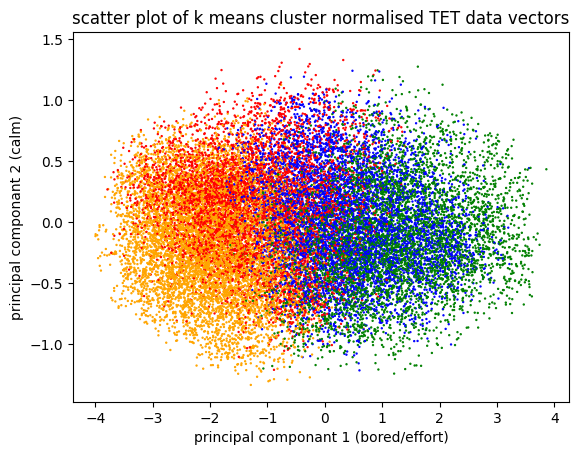

In [62]:
normalized_df[["principal componant 1", "principal componant 2"]] = normalized_df.dot(principal_components)
plt.xlabel("principal componant 1 (bored/effort)")
plt.ylabel("principal componant 2 (calm)")
plt.title("scatter plot of k means cluster normalised TET data vectors")
plt.scatter(normalized_df["principal componant 1"],normalized_df["principal componant 2"],color=point_colours_norm, s=0.5)
plt.savefig("C:/Users/hugma/diss/data/K_means_normalised_vector_scatter_plot")

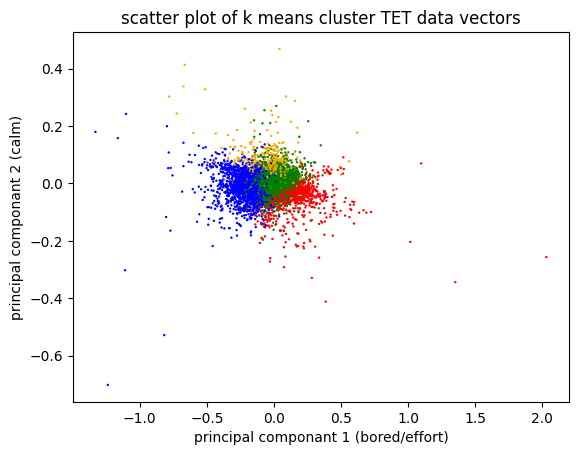

In [63]:
differences_array[["principal componant 1", "principal componant 2"]] = differences_array.iloc[:,-14:].dot(principal_components)
plt.xlabel("principal componant 1 (bored/effort)")
plt.ylabel("principal componant 2 (calm)")
plt.title("scatter plot of k means cluster TET data vectors")
plt.scatter(differences_array["principal componant 1"],differences_array["principal componant 2"],color=point_colours, s=0.5)
plt.savefig("C:/Users/hugma/diss/data/K_means_vector_scatter_plot")

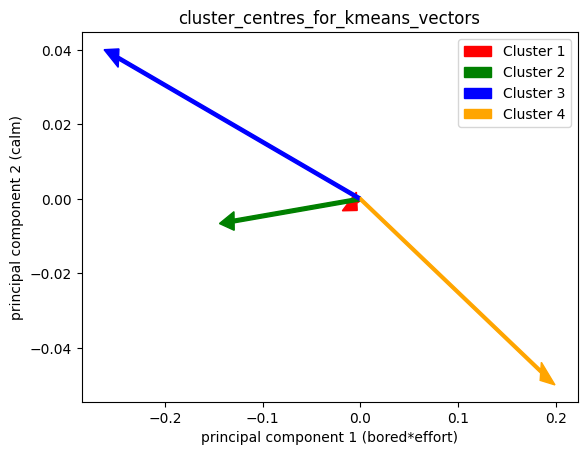

In [64]:
cluster_centres_prin = np.transpose(cluster_centres_fin.dot(principal_components),(1,0))
for i in range(cluster_centres_prin.shape[1]):
    plt.arrow(0, 0, cluster_centres_prin[0,i], cluster_centres_prin[1,i],
              head_width=0.005, head_length=0.015, fc=colours_list[i], ec=colours_list[i])

# Set the labels for the axes
plt.xlabel("principal component 1 (bored*effort)")
plt.ylabel("principal component 2 (calm)")

# Create the legend
legend = ['Cluster {}'.format(i+1) for i in range(cluster_centres_prin.shape[1])]
plt.legend(legend)
plt.title("cluster_centres_for_kmeans_vectors")
plt.savefig("c:/Users/hugma/diss/data/cluster_centres_for_kmeans_vectors")

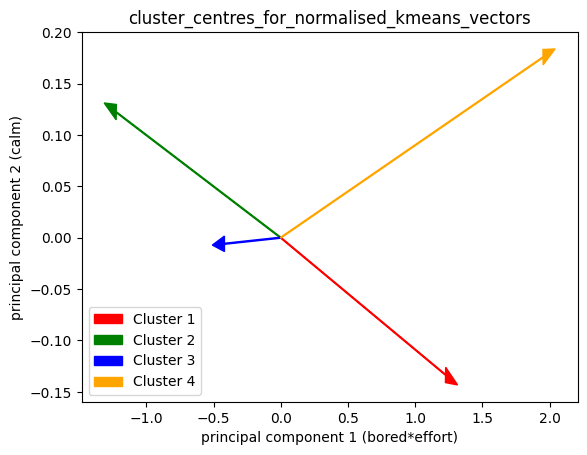

In [65]:
cluster_centres_prin_norm = np.transpose(cluster_centres_norm_fin.dot(principal_components),(1,0))
for i in range(cluster_centres_prin_norm.shape[1]):
    plt.arrow(0, 0, -cluster_centres_prin_norm[0,i], -cluster_centres_prin_norm[1,i],
              head_width=0.015, head_length=0.09, fc=colours_list[i], ec=colours_list[i])


plt.xlabel("principal component 1 (bored*effort)")
plt.ylabel("principal component 2 (calm)")

legend = ['Cluster {}'.format(i+1) for i in range(cluster_centres_prin_norm.shape[1])]
plt.legend(legend)
plt.title("cluster_centres_for_normalised_kmeans_vectors")
plt.savefig("c:/Users/hugma/diss/data/cluster_centres_for_normalised_kmeans_vectors")

In [66]:
differences_array['clust'] = labels_fin
transitions = []
for i in range(len(differences_array) - 1):
   transitions.append((differences_array.iloc[i]['clust'], differences_array.iloc[i+1]['clust']))
num_clusters = max(differences_array['clust']) + 1 

transition_matrix = np.zeros((num_clusters, num_clusters))

for (from_cluster, to_cluster) in transitions:
    transition_matrix[from_cluster, to_cluster] += 1

transition_matrix = transition_matrix / transition_matrix.sum(axis=1, keepdims=True)

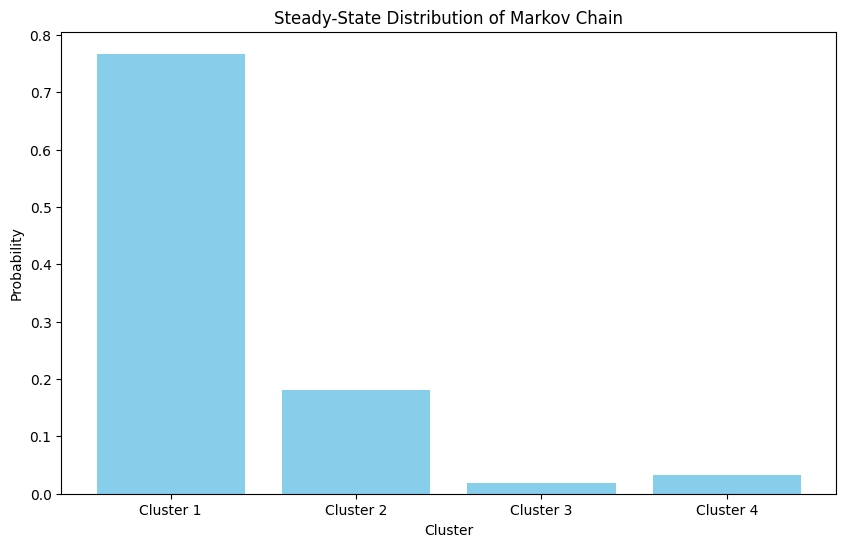

<Figure size 640x480 with 0 Axes>

In [67]:
n = transition_matrix.shape[0]
A = transition_matrix.T - np.eye(n)
A[-1] = np.ones(n)
b = np.zeros(n)
b[-1] = 1
pi = np.linalg.solve(A, b)
pi
plt.figure(figsize=(10, 6))
clusters = [f'Cluster {i+1}' for i in range(n)]
plt.bar(clusters, pi, color='skyblue')
plt.xlabel('Cluster')
plt.ylabel('Probability')
plt.title('Steady-State Distribution of Markov Chain')
plt.show()
plt.savefig("C:/Users/hugma/diss/data/steady-state distrbution for markov chain for kmeans clustering TET vectors")

In [68]:
differences_array_norm = differences_array.copy()
differences_array_norm['clust'] = labels_norm_fin
transitions_norm = []
for i in range(len(differences_array_norm) - 1):
   transitions_norm.append((differences_array_norm.iloc[i]['clust'], differences_array_norm.iloc[i+1]['clust']))
num_clusters_norm = max(differences_array_norm['clust']) + 1 

transition_matrix_norm = np.zeros((num_clusters_norm, num_clusters_norm))

for (from_cluster, to_cluster) in transitions_norm:
    transition_matrix_norm[from_cluster, to_cluster] += 1

transition_matrix_norm = transition_matrix_norm / transition_matrix_norm.sum(axis=1, keepdims=True)

In [69]:
differences_array_transitions = differences_array_MI[:-1].copy()
differences_array_transitions['transitions norm'] = transitions_norm
differences_array_transitions['transitions'] = transitions
differences_array_transitions.to_csv('c:/Users/hugma/diss/data/differences_array_transitions.csv',index=False)

In [70]:
feelings_diffs = ['MetaAwareness_diff', 'Presence_diff', 'PhysicalEffort_diff',
       'MentalEffort_diff', 'Boredom_diff', 'Receptivity_diff',
       'EmotionalIntensity_diff', 'Clarity_diff', 'Release_diff', 'Bliss_diff',
       'Embodiment_diff', 'Insightfulness_diff', 'Anxiety_diff',
       'SpiritualExperience_diff']
transitions_dict = {}
transitions_next_dict = {}
array_store = []
for heading, group in differences_array_transitions.groupby('transitions'):
    transitions_dict[heading] = group.copy()
for key, values in transitions_dict.items():
    frames = []  # List to store DataFrames for each iteration
    for index, value in values.iterrows():
        row_data = differences_array_MI[differences_array_MI['number'] == value['number']+1][feelings_diffs]
        frames.append(row_data)
    transitions_next_dict[key] = pd.concat(frames, axis=0)


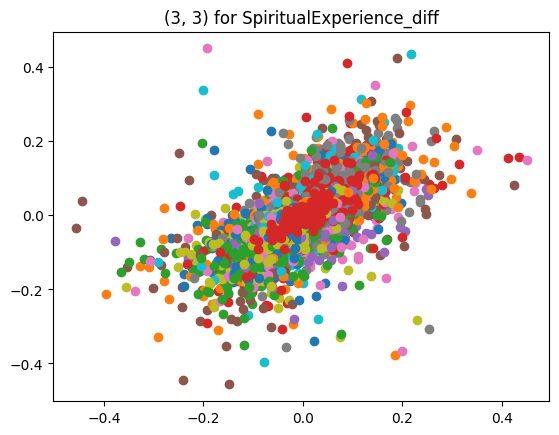

In [71]:
for feeling in feelings_diffs:    
    for key, value in transitions_next_dict.items():
    
        plt.scatter(transitions_dict[key][feeling],value[feeling])
        plt.title(f"{key} for {feeling}")


In [72]:
transitions_change_dict = {}

for key, values in transitions_next_dict.items():
    result = transitions_next_dict[key].values - transitions_dict[key][feelings_diffs].values
    result_df = pd.DataFrame(result, index=transitions_next_dict[key].index, columns=transitions_next_dict[key].columns)
    transitions_change_dict[key] = result_df


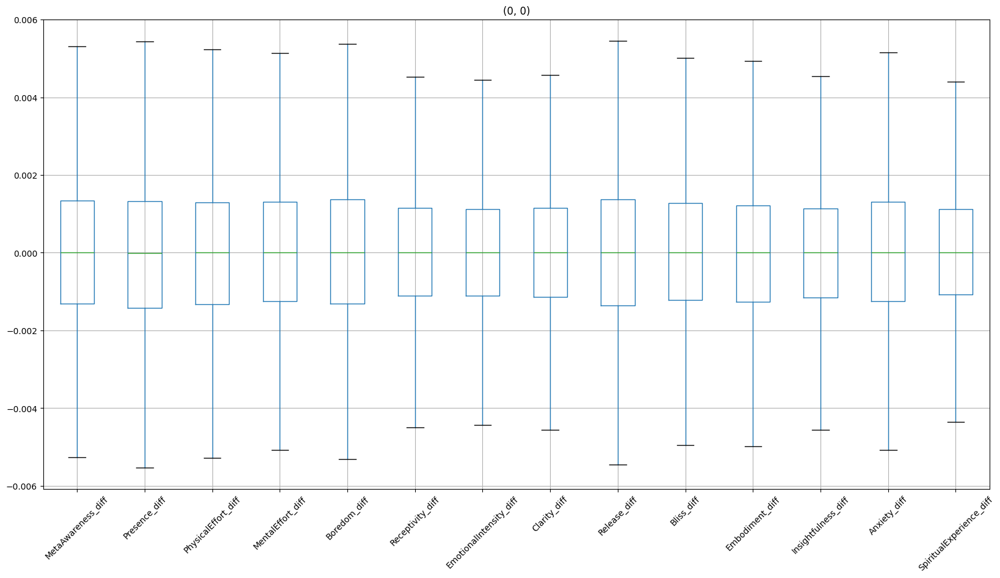

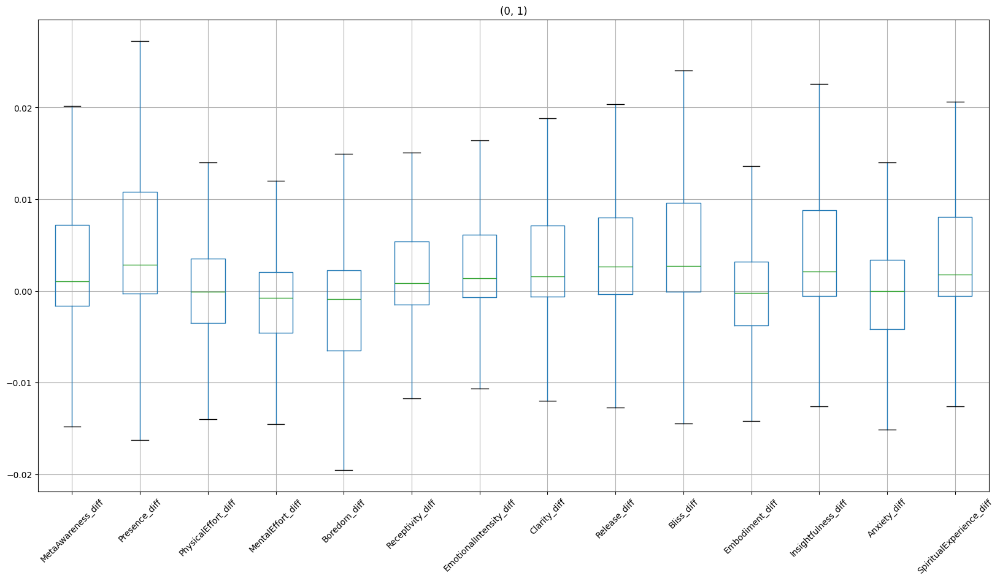

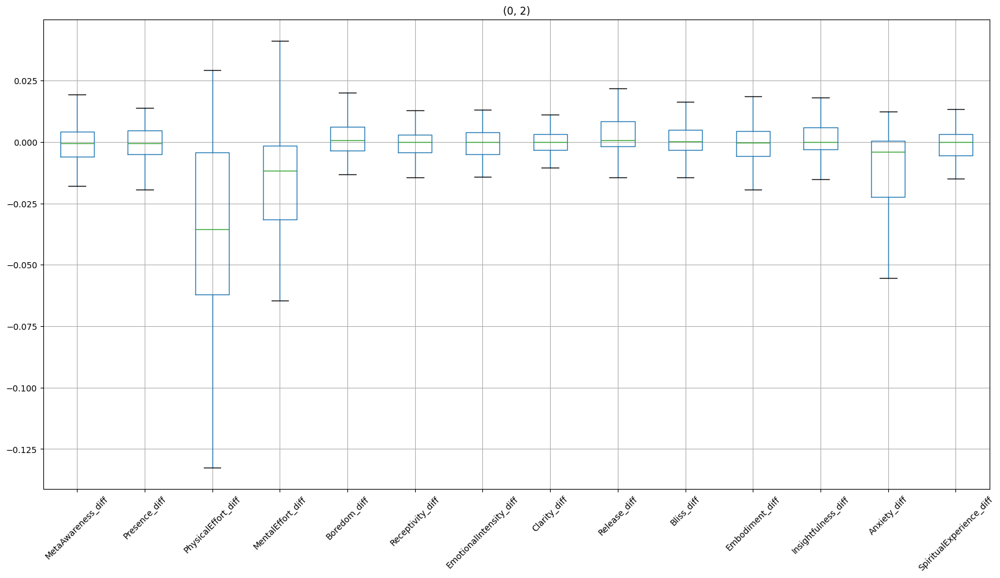

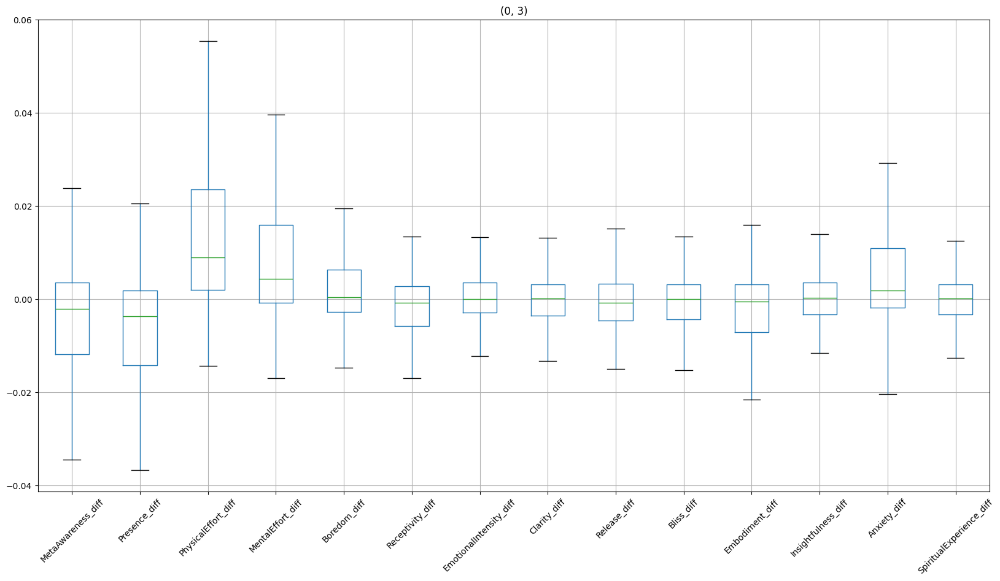

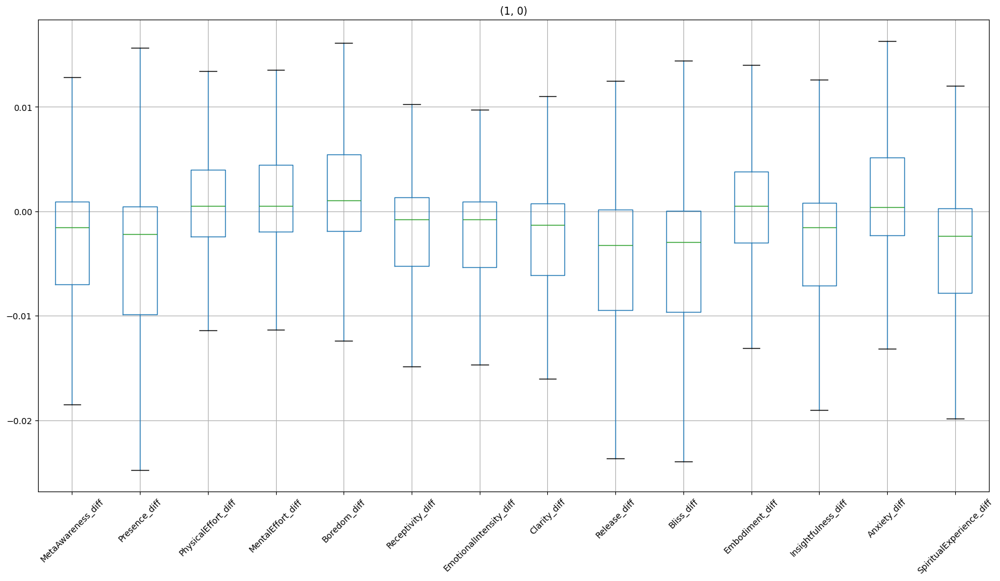

...

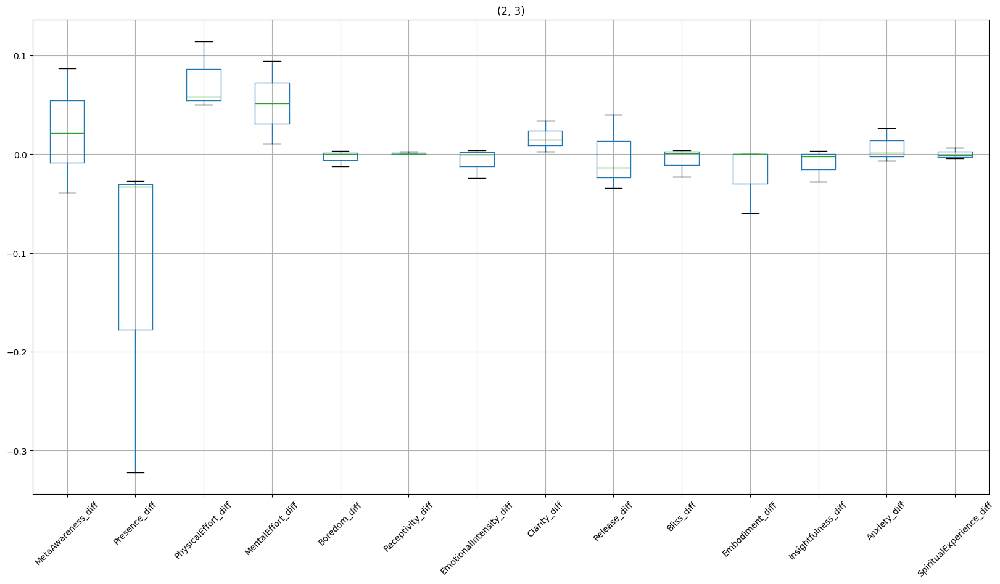

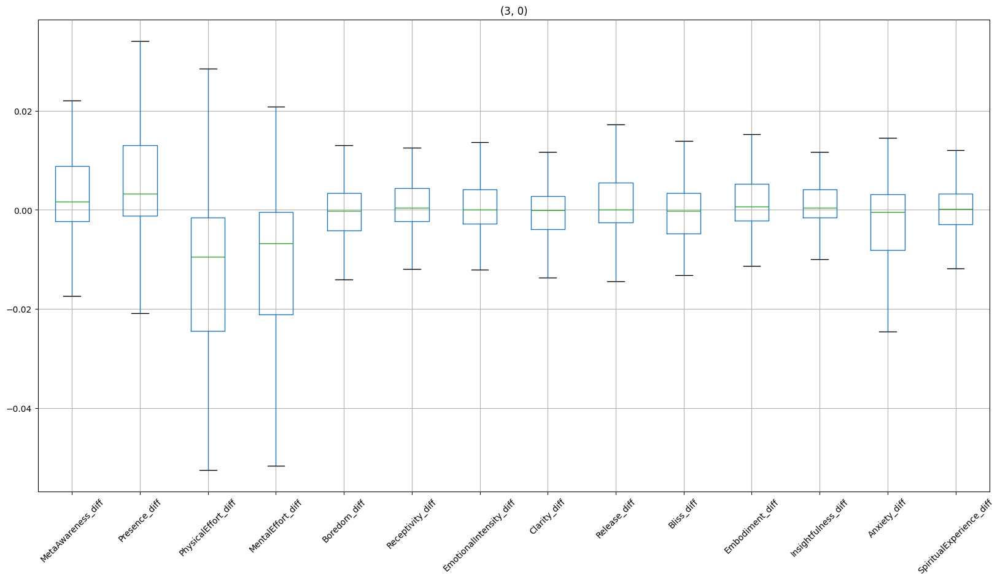

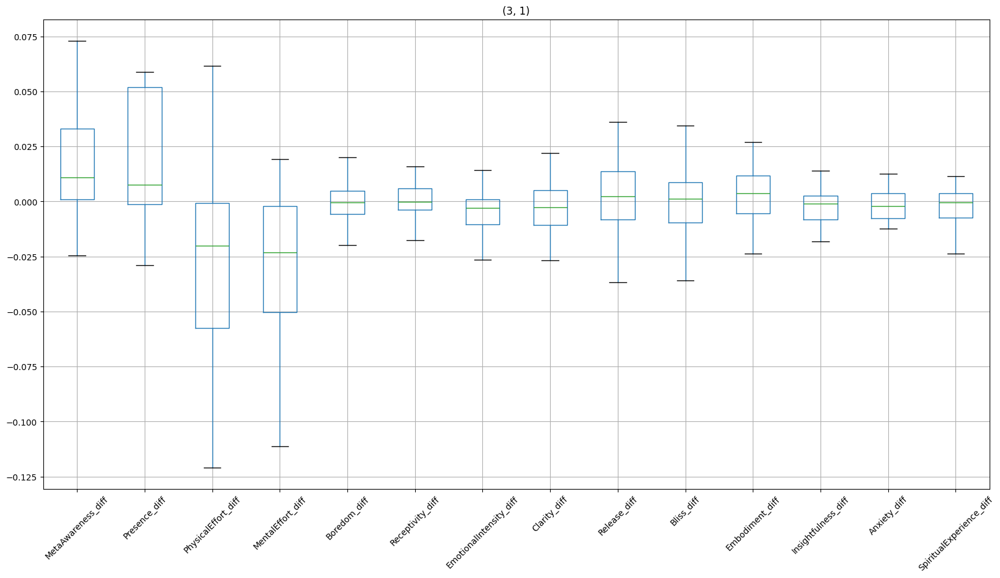

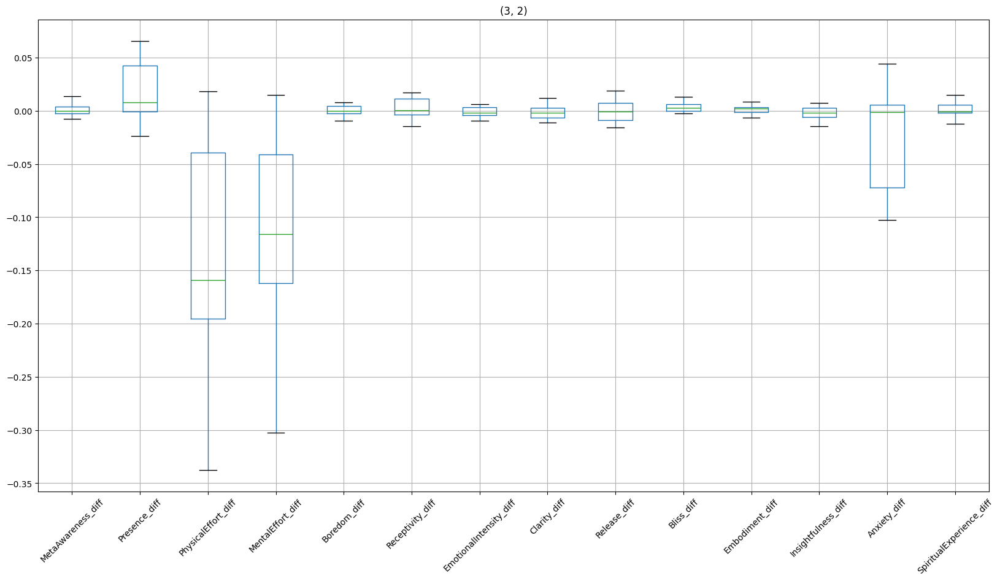

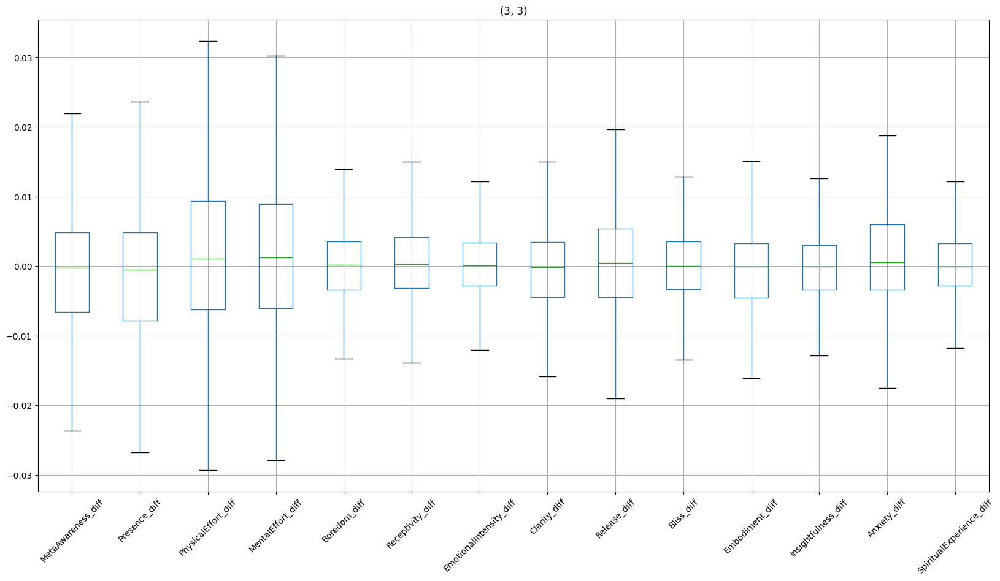

In [73]:
for key, values in transitions_change_dict.items():
    plt.figure(figsize=(20, 10))  # Adjust the size as needed
    values.boxplot(showfliers=False)
    plt.xticks(rotation=45)  # Rotate the column names for better readability
    plt.title(key)
    plt.show()

In [74]:
transitions_dict_norm = {}
transitions_next_dict_norm = {}
array_store_norm = []
for heading, group in differences_array_transitions.groupby('transitions norm'):
    transitions_dict_norm[heading] = group.copy()
for key, values in transitions_dict_norm.items():
    frames = []  # List to store DataFrames for each iteration
    for index, value in values.iterrows():
        row_data = differences_array_MI[differences_array_MI['number'] == value['number']+1][feelings_diffs]
        frames.append(row_data)
    transitions_next_dict_norm[key] = pd.concat(frames, axis=0)

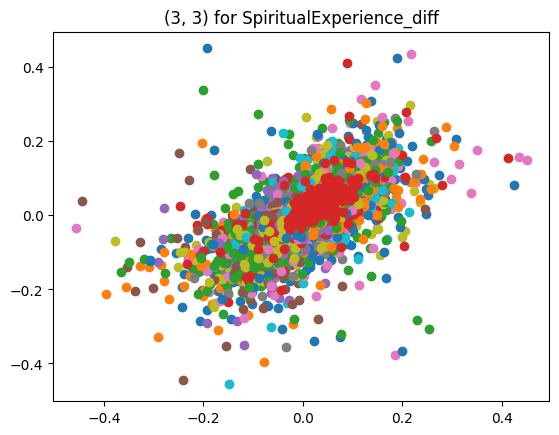

In [75]:
for feeling in feelings_diffs:    
    for key, value in transitions_next_dict_norm.items():
    
        plt.scatter(transitions_dict_norm[key][feeling],value[feeling])
        plt.title(f"{key} for {feeling}")

In [76]:
transitions_change_dict_norm = {}

for key, values in transitions_next_dict_norm.items():
    result = transitions_next_dict_norm[key].values - transitions_dict_norm[key][feelings_diffs].values
    result_df = pd.DataFrame(result, index=transitions_next_dict_norm[key].index, columns=transitions_next_dict_norm[key].columns)
    transitions_change_dict_norm[key] = result_df

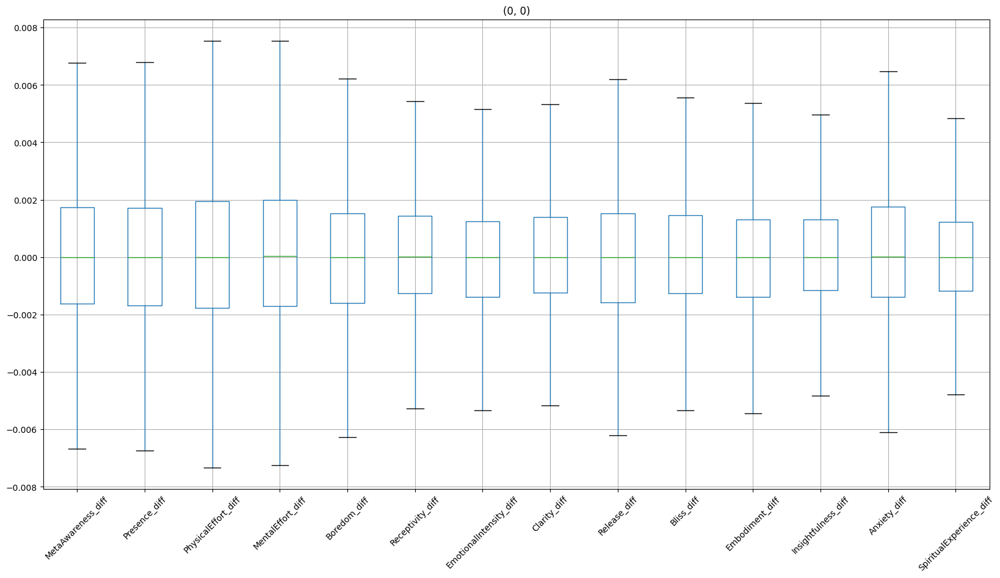

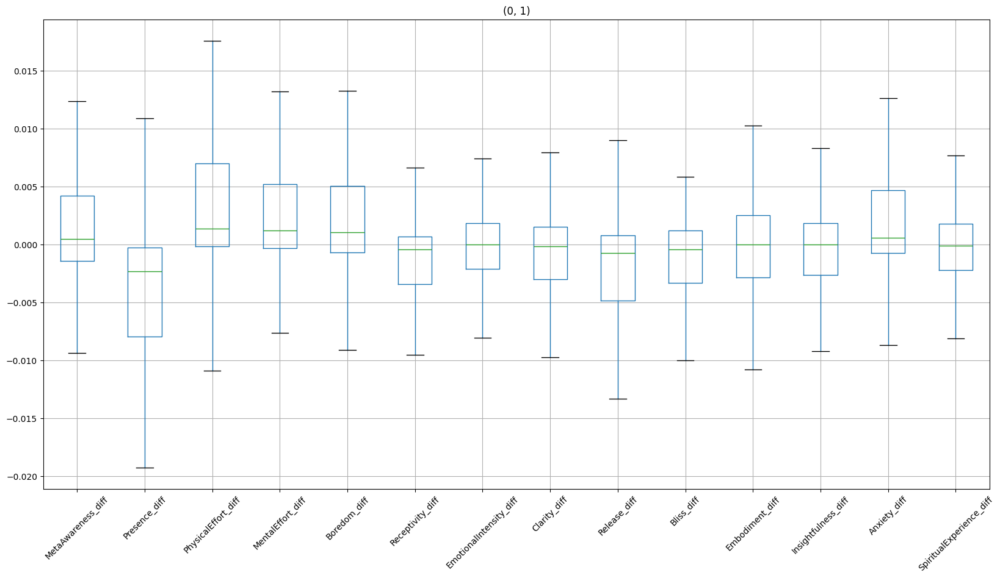

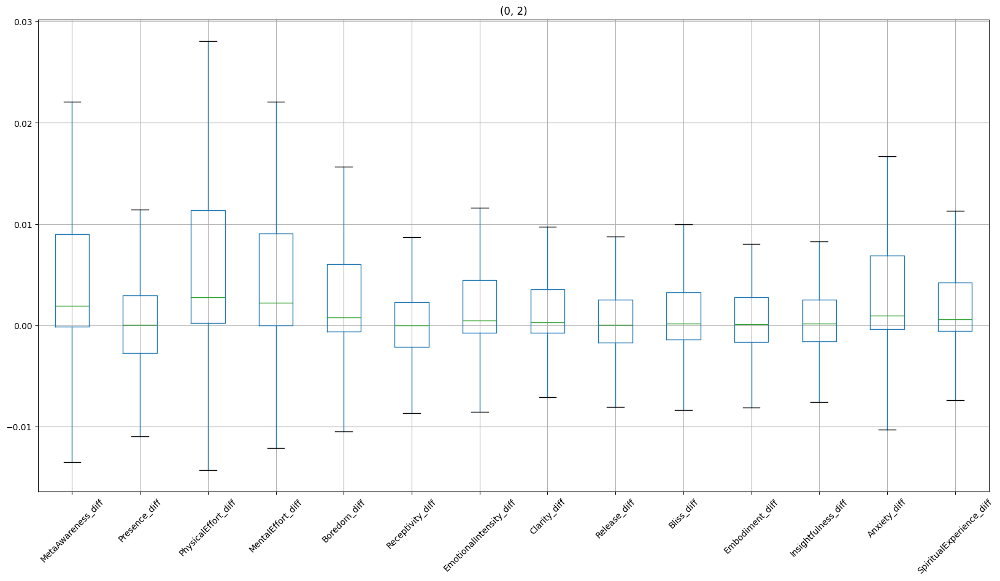

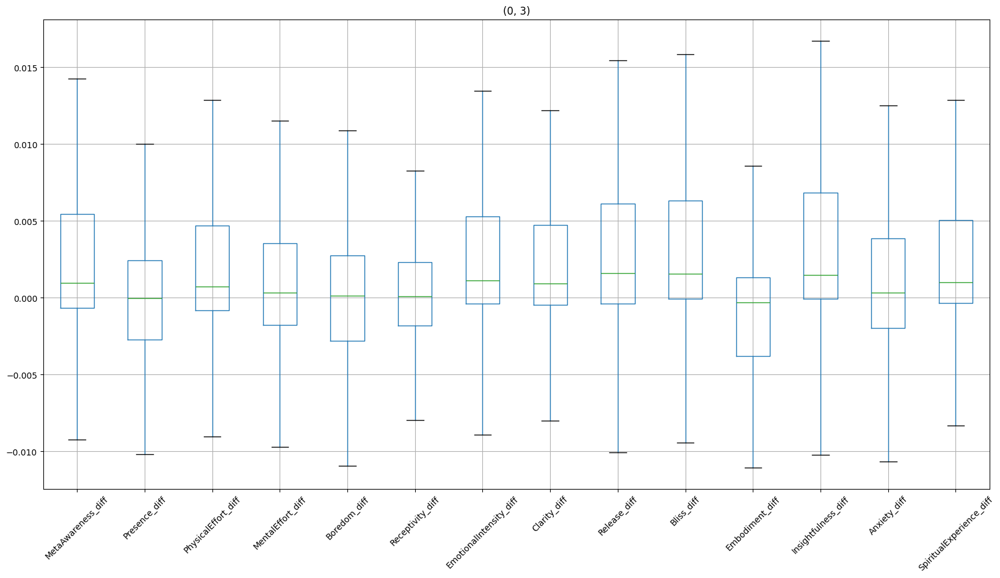

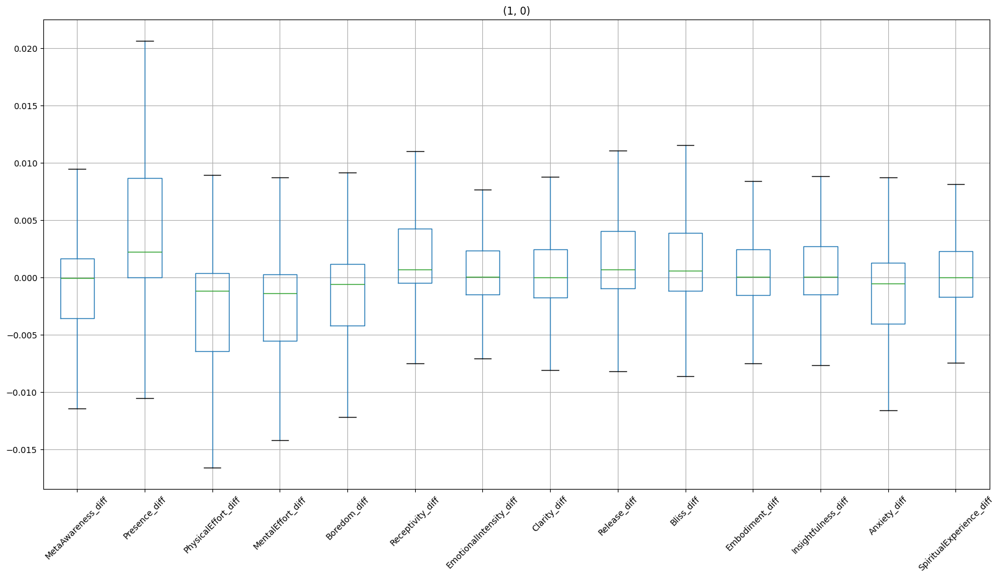

...

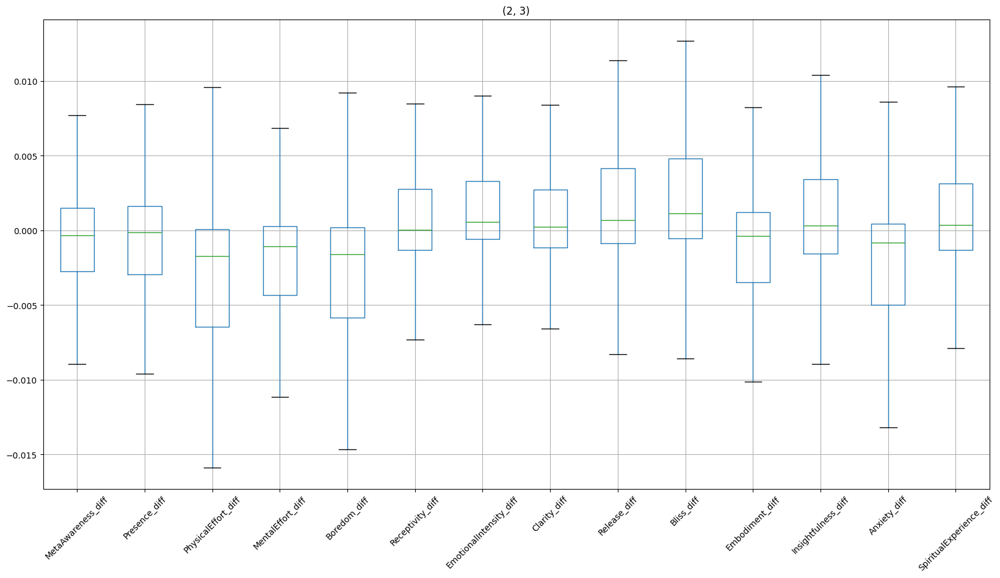

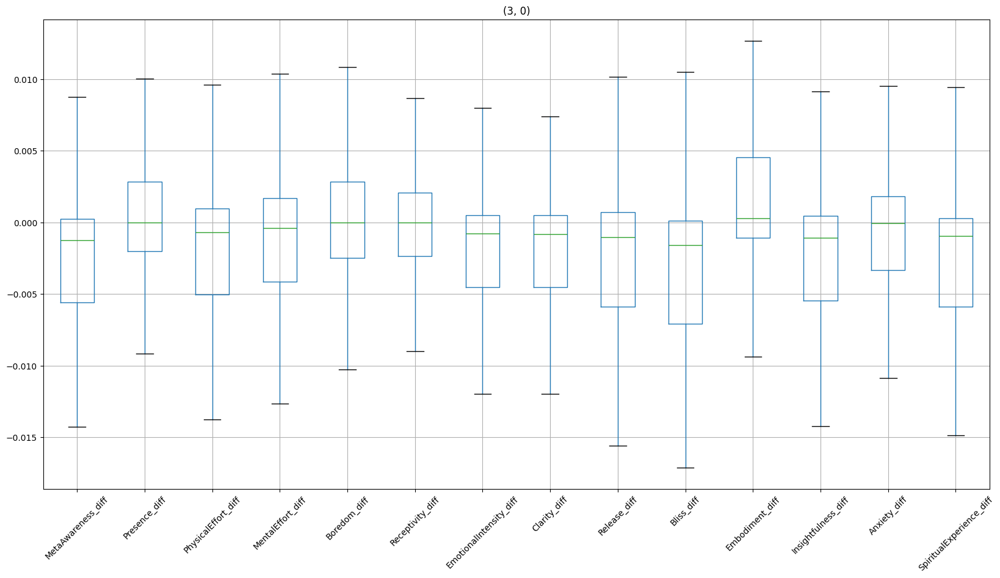

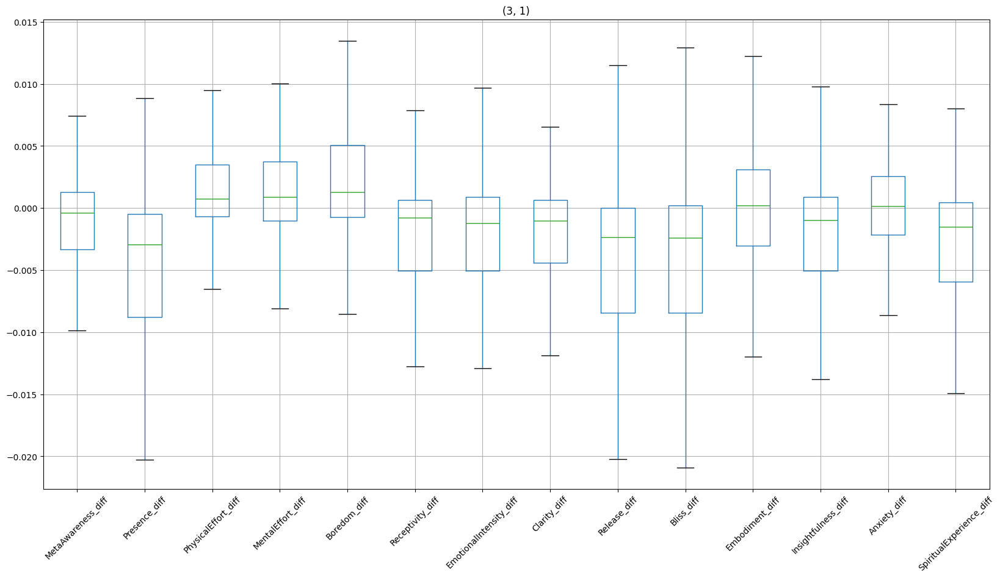

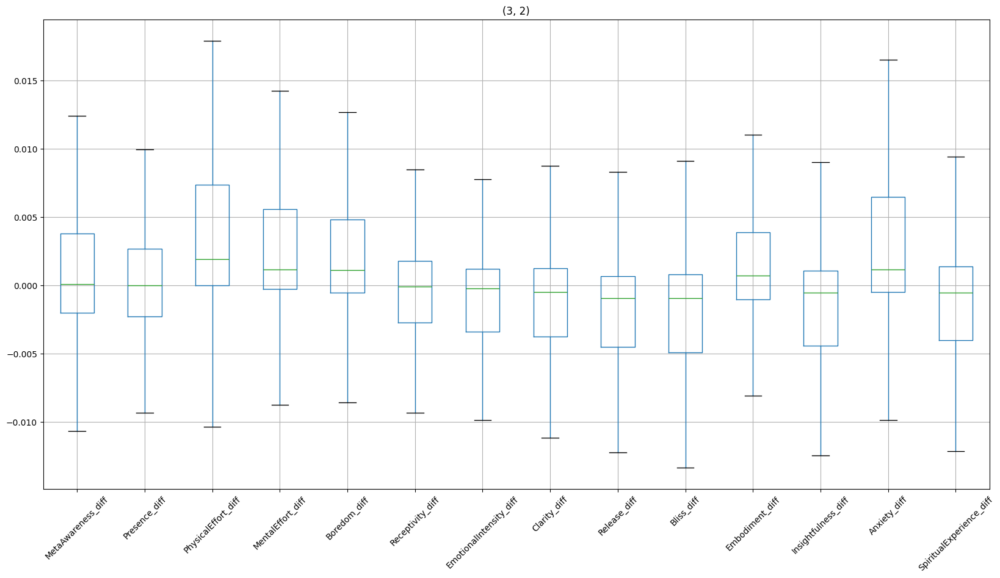

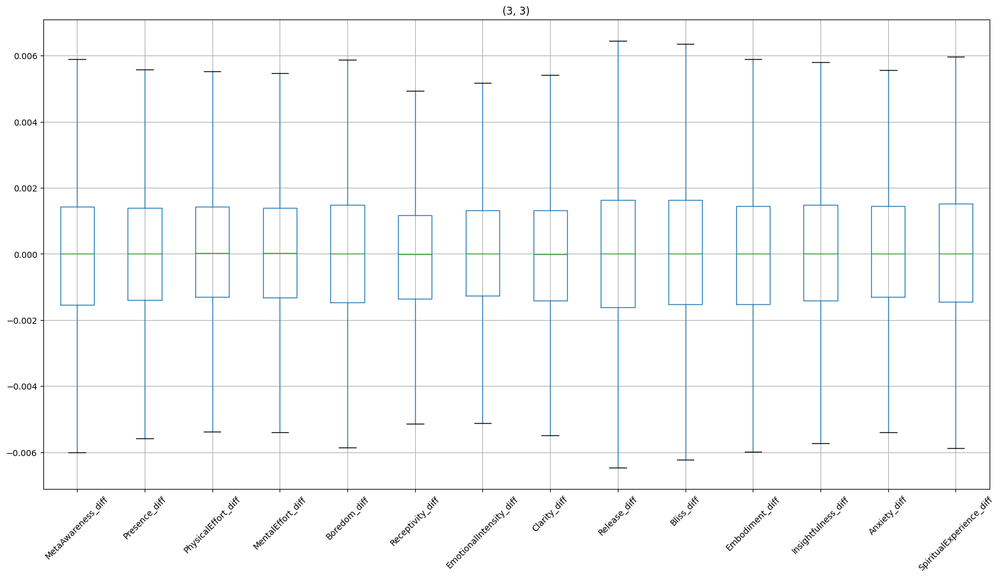

In [77]:
for key, values in transitions_change_dict_norm.items():
    plt.figure(figsize=(20, 10))  # Adjust the size as needed
    values.boxplot(showfliers=False)
    plt.xticks(rotation=45)  # Rotate the column names for better readability
    plt.title(key)
    plt.show()

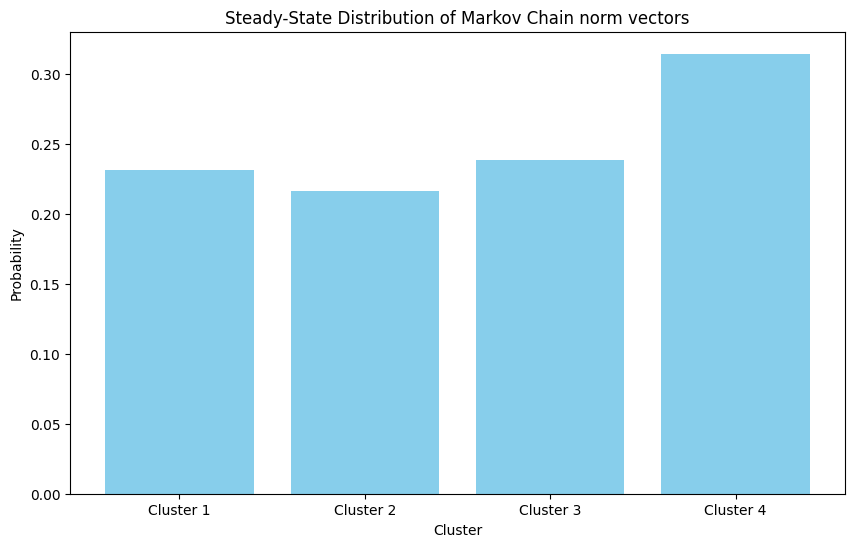

In [78]:
n = transition_matrix_norm.shape[0]
A = transition_matrix_norm.T - np.eye(n)
A[-1] = np.ones(n)
b = np.zeros(n)
b[-1] = 1
pi = np.linalg.solve(A, b)
pi
plt.figure(figsize=(10, 6))
clusters = [f'Cluster {i+1}' for i in range(n)]
plt.bar(clusters, pi, color='skyblue')
plt.xlabel('Cluster')
plt.ylabel('Probability')
plt.title('Steady-State Distribution of Markov Chain norm vectors')
plt.savefig("C:/Users/hugma/diss/data/steady-state distrbution for markov chain for normalised kmeans clustering TET vectors")
plt.show()


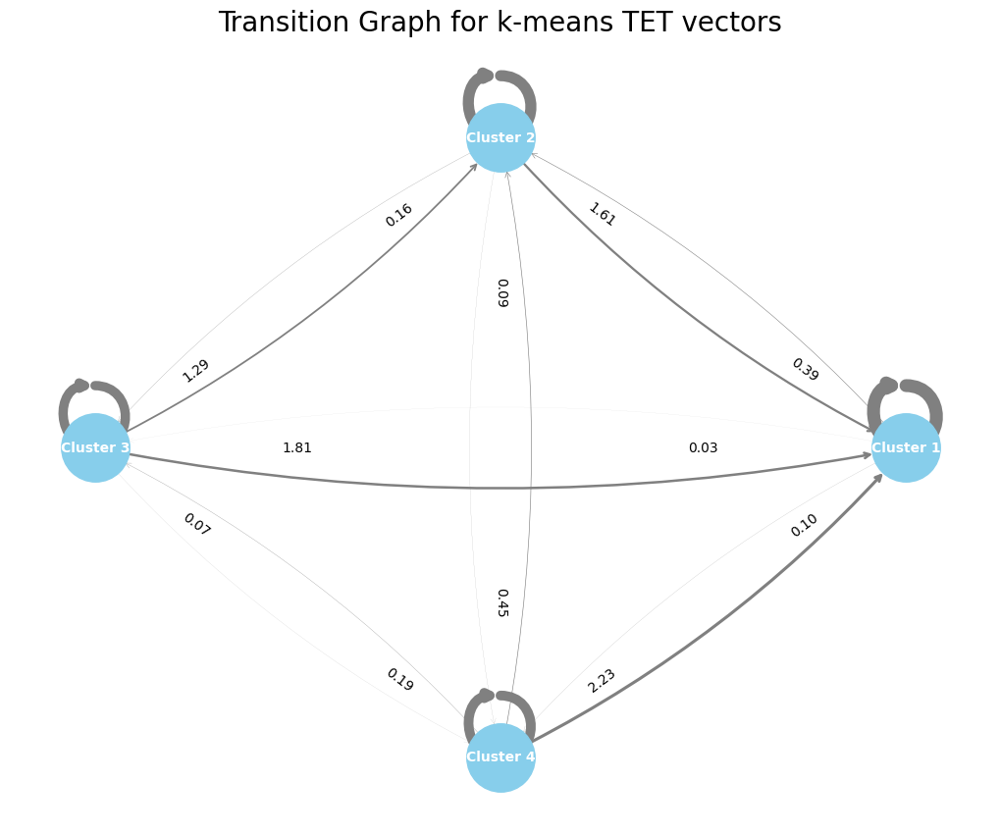

In [79]:
G = nx.DiGraph()

# Add nodes and edges with weights
for i in range(len(transition_matrix)):
    for j in range(len(transition_matrix[i])):
        prob = transition_matrix[i][j]
        if prob > 0:  # Only add an edge if the probability is non-zero
            # The edge width will be proportional to the probability
            G.add_edge(f'Cluster {i+1}', f'Cluster {j+1}', weight=prob*10)  # Multiply by a factor for better visualization

# Draw the graph
plt.figure(figsize=(10, 8))
pos = nx.circular_layout(G)  # Position nodes in a circle

# Extract weights and apply as widths
edge_weights = nx.get_edge_attributes(G, 'weight')
edge_widths = [edge_weights[edge] for edge in G.edges()]
edge_labels = {(u, v): f'{d["weight"]:.2f}' for u, v, d in G.edges(data=True)}

nx.draw(G, pos, node_color='skyblue', node_size=2500, width=edge_widths, arrowstyle='->', connectionstyle='arc3,rad=0.1', edge_color='grey')
nx.draw_networkx_labels(G, pos, font_size=10, font_weight='bold', font_color='white')
nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels, label_pos=0.75, font_size=10)
# Remove the axis
plt.axis('off')

plt.title('Transition Graph for k-means TET vectors', size=20)
plt.savefig("C:/Users/hugma/diss/data/transition graph for markov chain for kmeans clustering TET vectors")
plt.show()




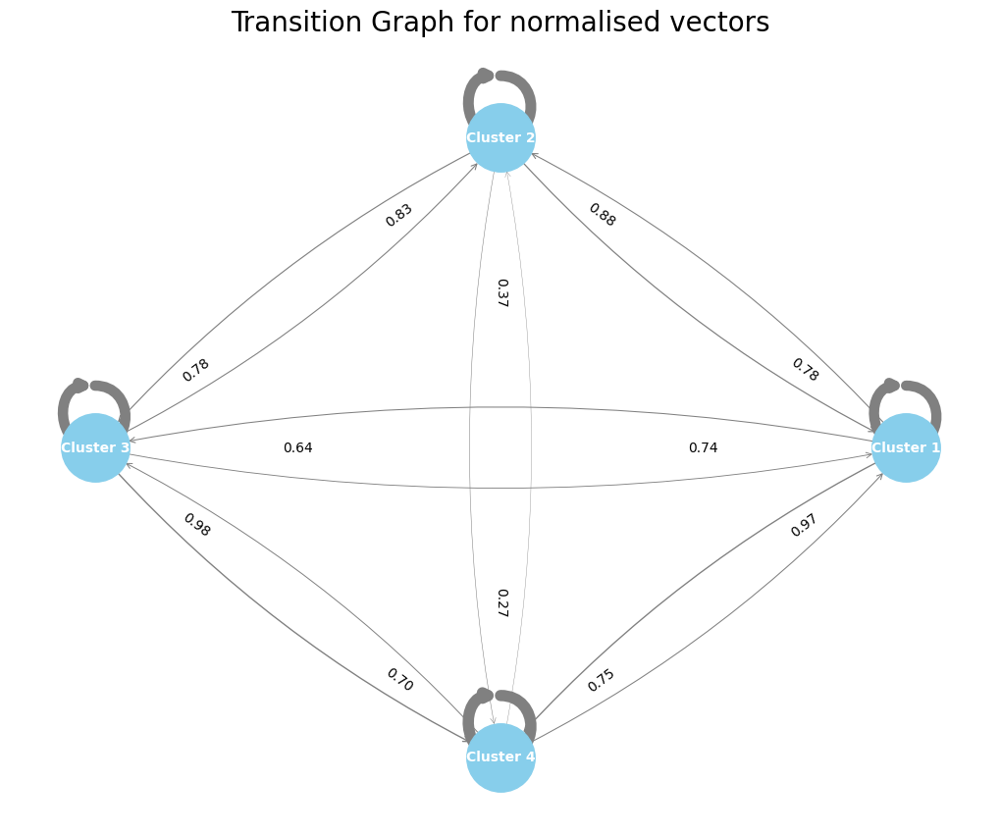

In [80]:
G = nx.DiGraph()

# Add nodes and edges with weights
for i in range(len(transition_matrix_norm)):
    for j in range(len(transition_matrix_norm[i])):
        prob = transition_matrix_norm[i][j]
        if prob > 0:  # Only add an edge if the probability is non-zero
            # The edge width will be proportional to the probability
            G.add_edge(f'Cluster {i+1}', f'Cluster {j+1}', weight=prob*10)  # Multiply by a factor for better visualization

# Draw the graph
plt.figure(figsize=(10, 8))
pos = nx.circular_layout(G)  # Position nodes in a circle

# Extract weights and apply as widths
edge_weights = nx.get_edge_attributes(G, 'weight')
edge_widths = [edge_weights[edge] for edge in G.edges()]
edge_labels = {(u, v): f'{d["weight"]:.2f}' for u, v, d in G.edges(data=True)}
nx.draw(G, pos, node_color='skyblue', node_size=2500, width=edge_widths, arrowstyle='->', connectionstyle='arc3,rad=0.1', edge_color='grey')
nx.draw_networkx_labels(G, pos, font_size=10, font_weight='bold', font_color='white')
nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels, label_pos=0.75, font_size=10)
# Remove the axis
plt.axis('off')

plt.title('Transition Graph for normalised vectors', size=20)
plt.savefig("C:/Users/hugma/diss/data/steady-state distrbution for markov chain for normalised kmeans clustering TET vectors")
plt.show()


<Figure size 1000x800 with 0 Axes>

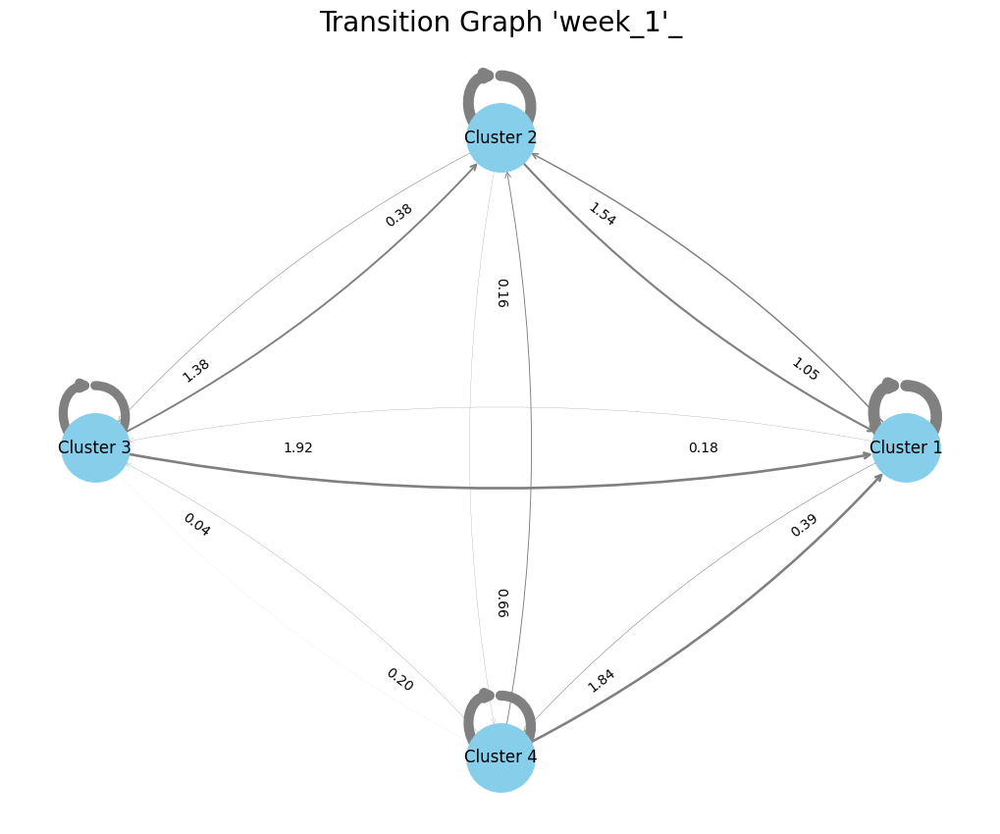

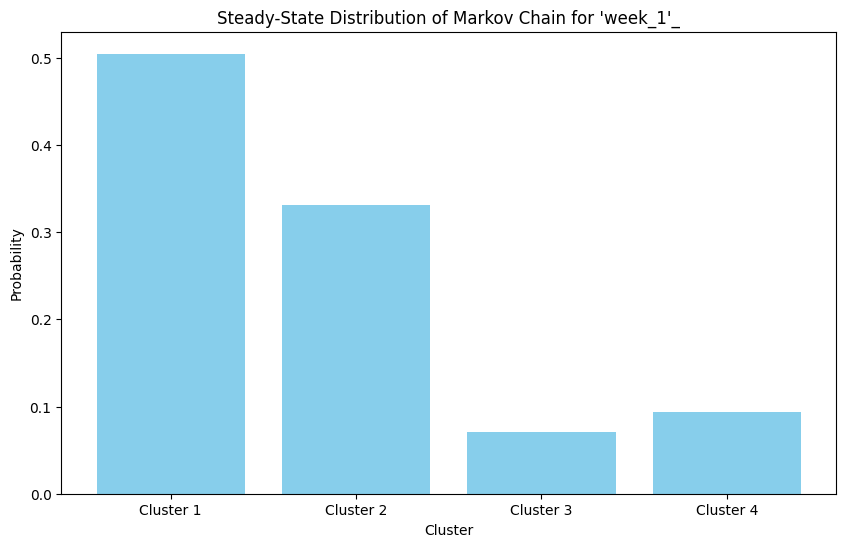

<Figure size 1000x800 with 0 Axes>

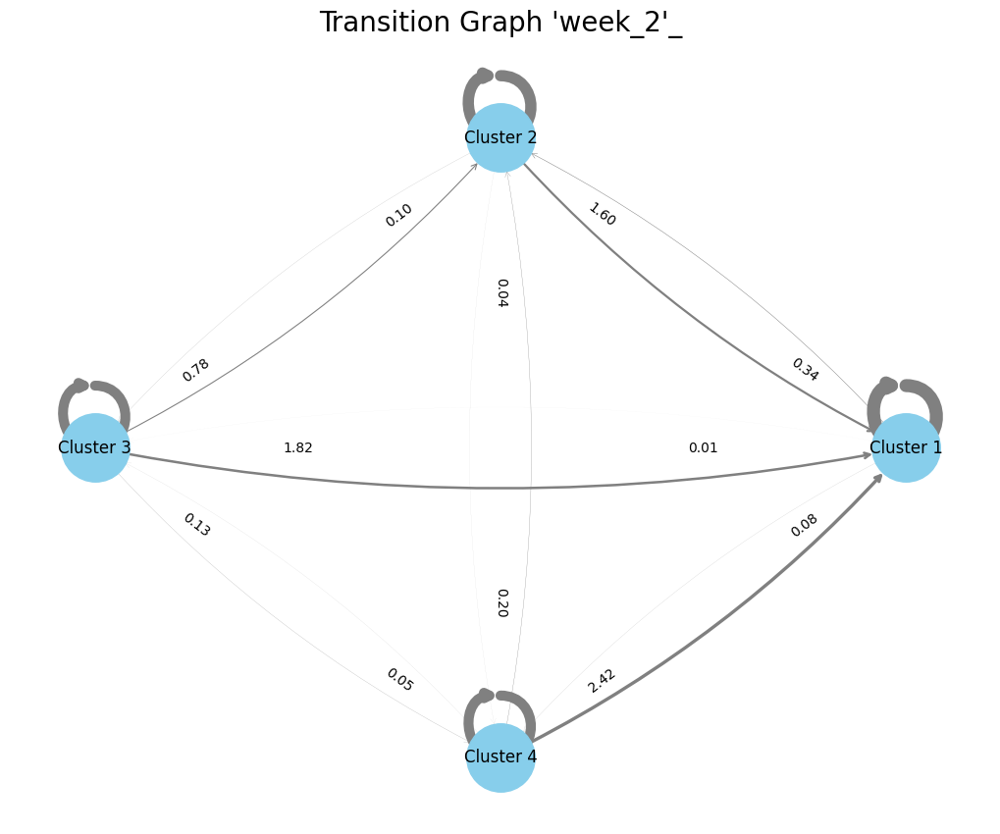

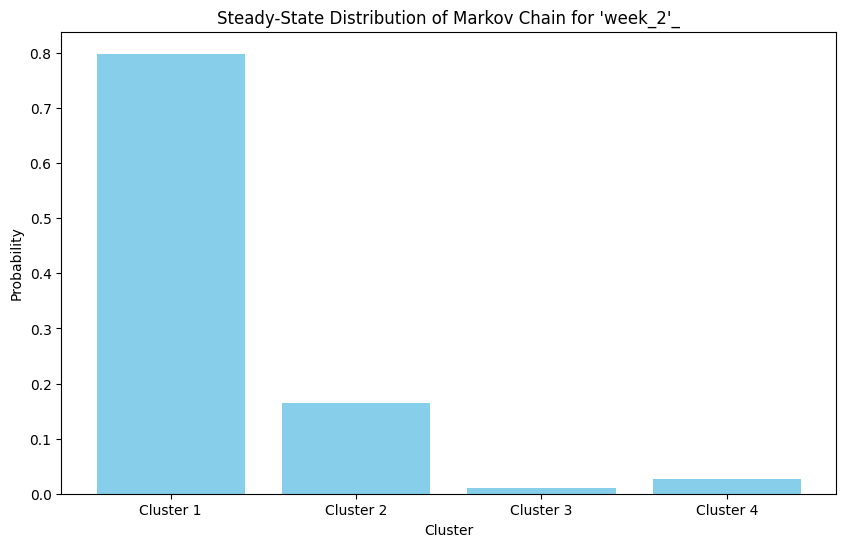

<Figure size 1000x800 with 0 Axes>

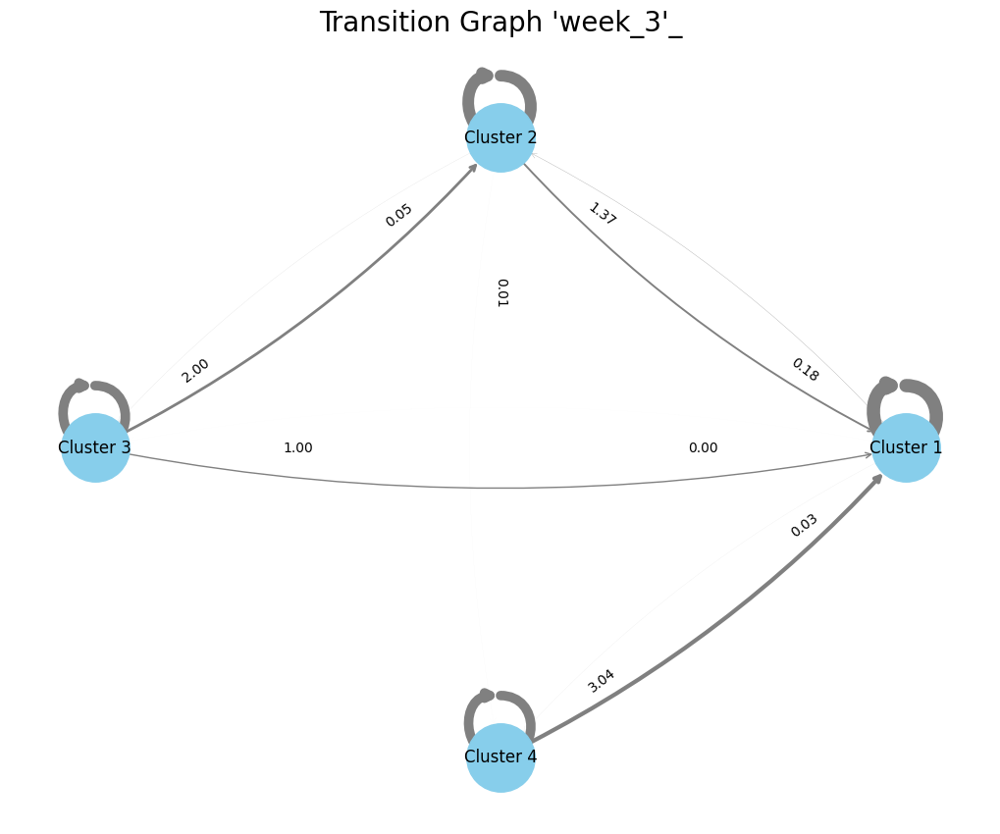

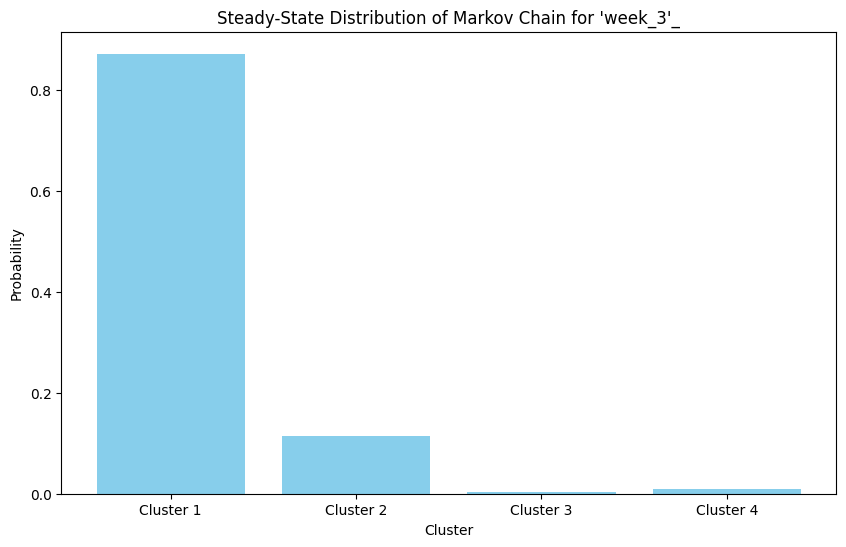

<Figure size 1000x800 with 0 Axes>

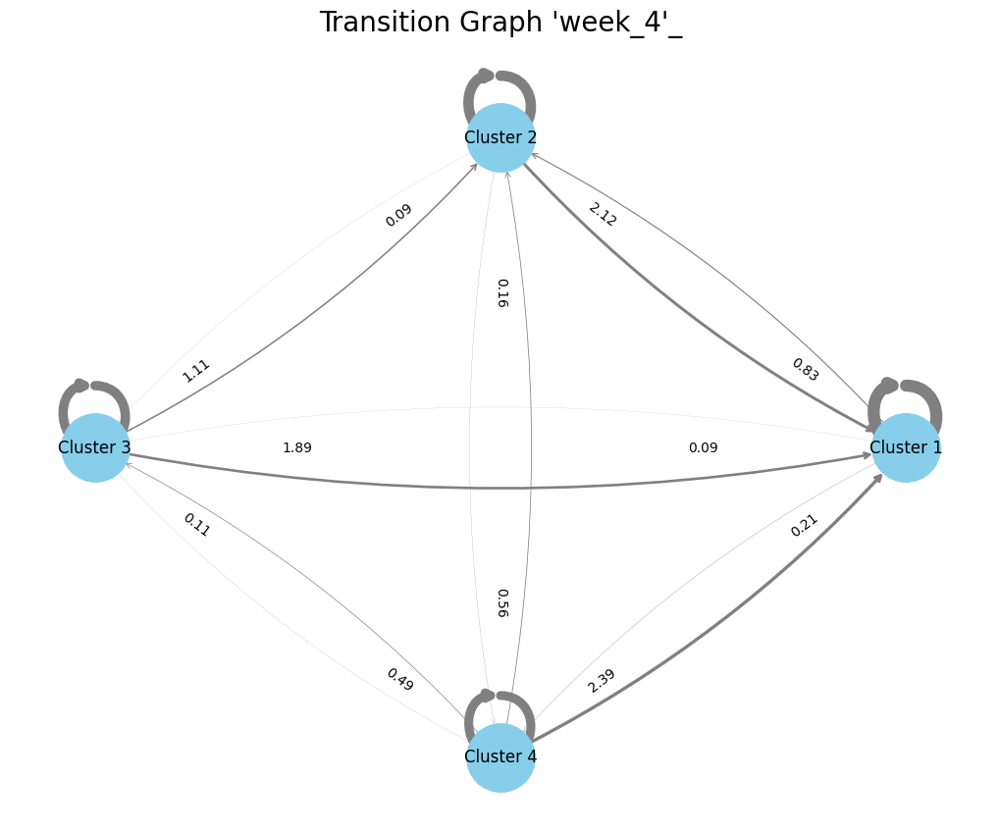

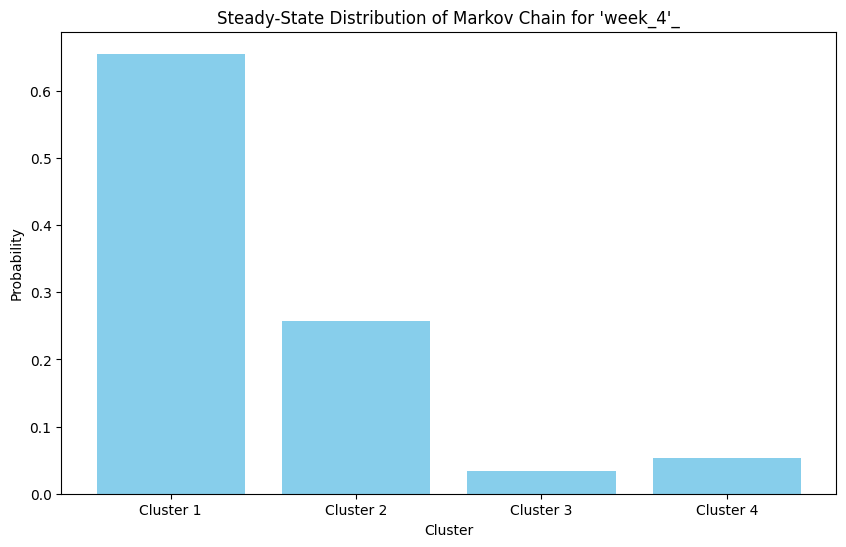

In [81]:
split_dict = {}
transition_matrices_dict = {}
for heading,group in differences_array.groupby([header]):
    split_dict[heading] = group.copy()
for key,value in split_dict.items():
    transitions_key = []
    for i in range(len(value) - 1):
        transitions_key.append((value.iloc[i]['clust'], value.iloc[i+1]['clust']))
        num_clusters = max(value['clust']) + 1 

    transition_matrix_key = np.zeros((num_clusters, num_clusters))

    for (from_cluster, to_cluster) in transitions_key:
        transition_matrix_key[from_cluster, to_cluster] += 1

    transition_matrix_key = transition_matrix_key / transition_matrix_key.sum(axis=1, keepdims=True)
    transition_matrices_dict[key] = transition_matrix_key
    G = nx.DiGraph()

    # Add nodes and edges with weights
    for i in range(len(transition_matrix_key)):
        for j in range(len(transition_matrix_key[i])):
            prob = transition_matrix_key[i][j]
            if prob > 0:  # Only add an edge if the probability is non-zero
                # The edge width will be proportional to the probability
                G.add_edge(f'Cluster {i+1}', f'Cluster {j+1}', weight=prob*10)  # Multiply by a factor for better visualization

    # Draw the graph
    plt.figure(figsize=(10, 8))
    pos = nx.circular_layout(G)  # Position nodes in a circle

    # Extract weights and apply as widths
    edge_weights = nx.get_edge_attributes(G, 'weight')
    edge_widths = [edge_weights[edge] for edge in G.edges()]

    edge_labels = {(u, v): f'{d["weight"]:.2f}' for u, v, d in G.edges(data=True)}


    plt.figure(figsize=(10, 8))
    nx.draw(G, pos, with_labels=True, node_color='skyblue', node_size=2500, width=edge_widths, arrowstyle='->', connectionstyle='arc3,rad=0.1', edge_color='grey')
   

    # Draw edge labels with corrected labels
    nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels, label_pos=0.75, font_size=10)
    safe_key = str(key).replace("\\", "").replace("/", "").replace("(", "").replace(")", "").replace(",", "_")
    # Remove the axis
    plt.axis('off')

    plt.title(f'Transition Graph {safe_key}', size=20)
    plt.savefig(f"C:/Users/hugma/diss/data/Transition_Graph_{safe_key}")
    plt.show()
    
    n = transition_matrix_key.shape[0]
    A = transition_matrix_key.T - np.eye(n)
    A[-1] = np.ones(n)
    b = np.zeros(n)
    b[-1] = 1
    pi = np.linalg.solve(A, b)
    pi
    plt.figure(figsize=(10, 6))
    clusters = [f'Cluster {i+1}' for i in range(n)]
    plt.bar(clusters, pi, color='skyblue')
    plt.xlabel('Cluster')
    plt.ylabel('Probability')
    plt.title(f'Steady-State Distribution of Markov Chain for {safe_key}')
    plt.savefig(f"C:/Users/hugma/diss/data/Steady-State Distribution of Markov Chain for {safe_key}")
    plt.show()
    

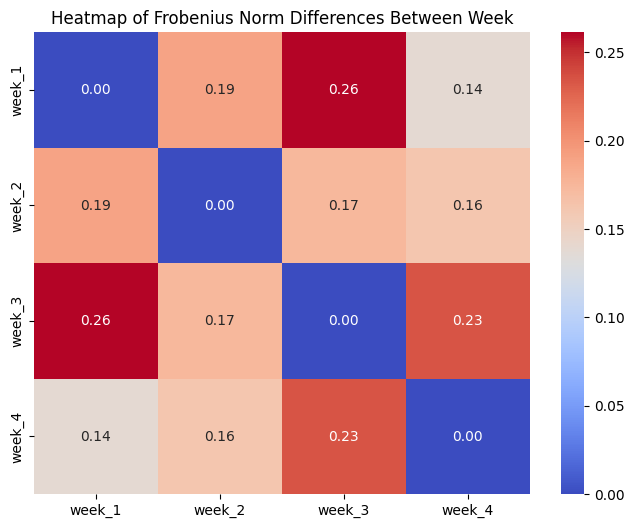

In [82]:
headers = list(transition_matrices_dict.keys())
frobenius_matrix = np.zeros((len(headers), len(headers)))

for i in range(len(headers)):
    for j in range(i + 1, len(headers)):
        diff_matrix = transition_matrices_dict[headers[i]] - transition_matrices_dict[headers[j]]
        frob_norm = np.linalg.norm(diff_matrix, 'fro')
        frobenius_matrix[i, j] = frob_norm
        frobenius_matrix[j, i] = frob_norm  
headers = [str(header).strip("(),'") for header in headers]
plt.figure(figsize=(8, 6))
ax = sns.heatmap(frobenius_matrix, annot=True, fmt=".2f", xticklabels=headers, yticklabels=headers, cmap="coolwarm")
plt.title(f'Heatmap of Frobenius Norm Differences Between {header}')
plt.savefig(f"C:/Users/hugma/diss/data/Heatmap of Frobenius Norm Differences Between {header}")
plt.show()


<Figure size 1000x800 with 0 Axes>

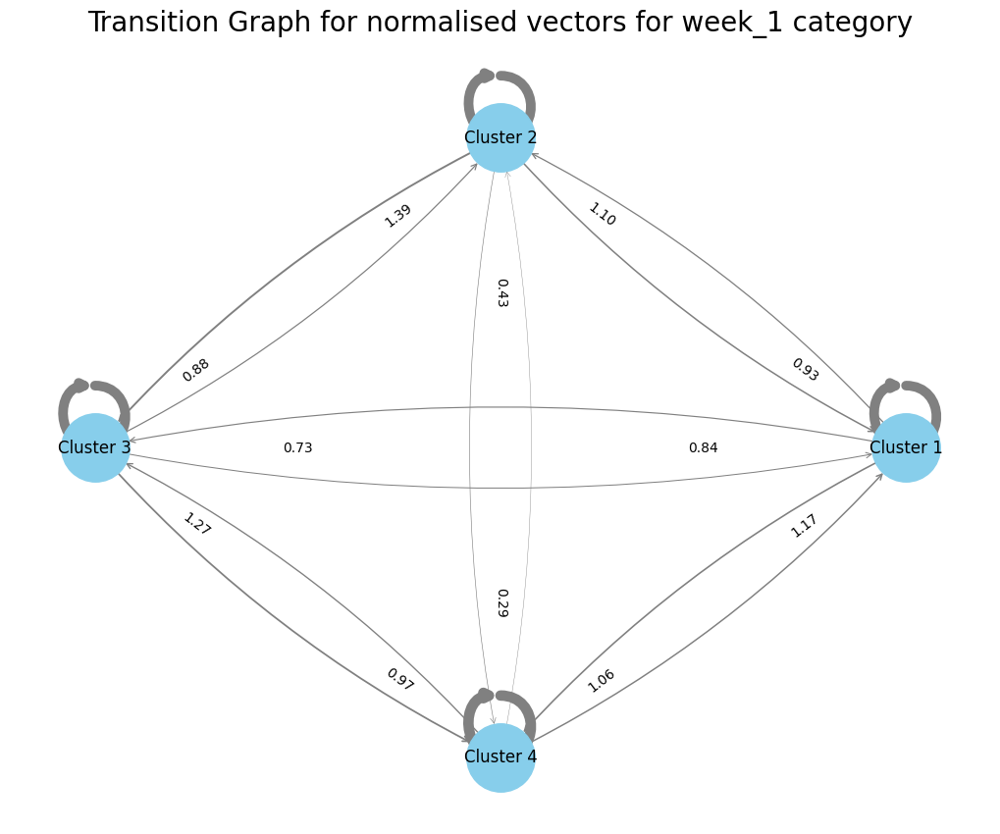

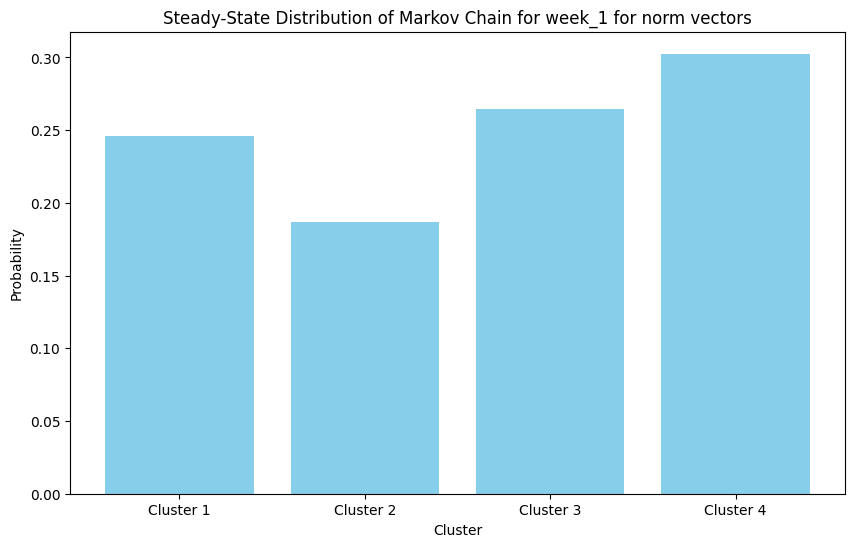

<Figure size 1000x800 with 0 Axes>

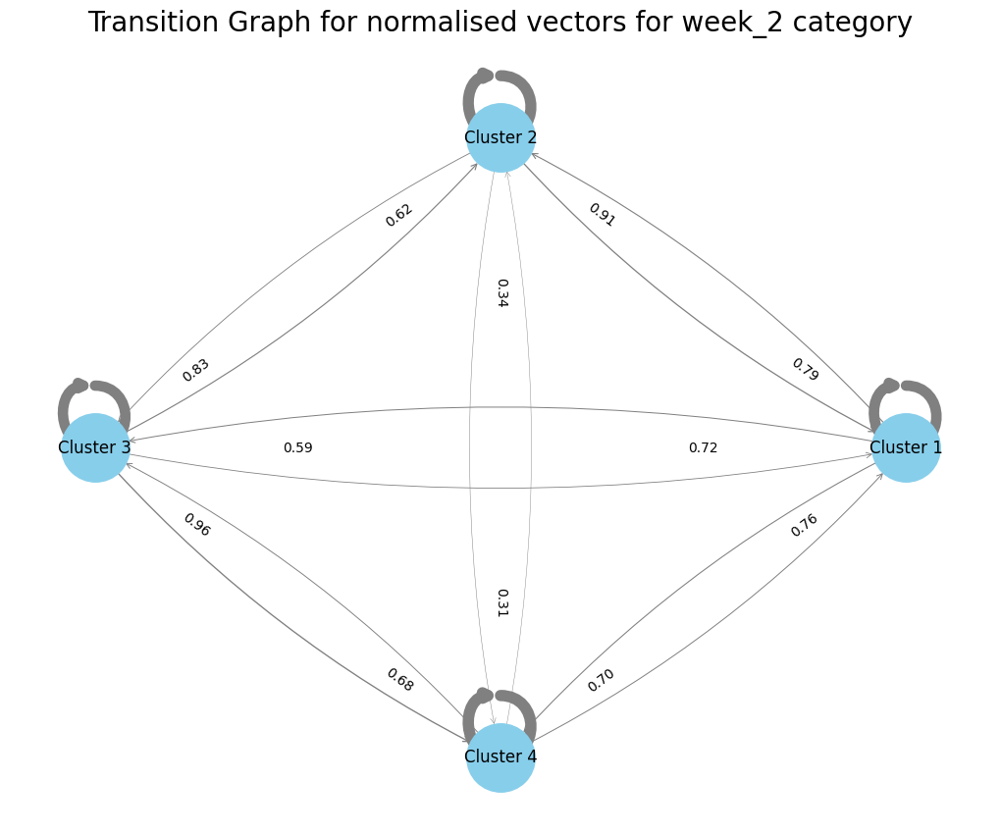

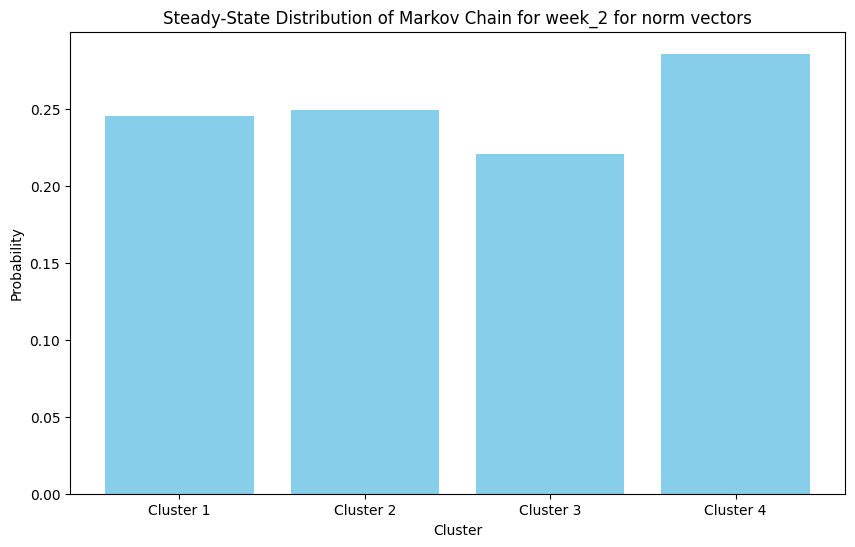

<Figure size 1000x800 with 0 Axes>

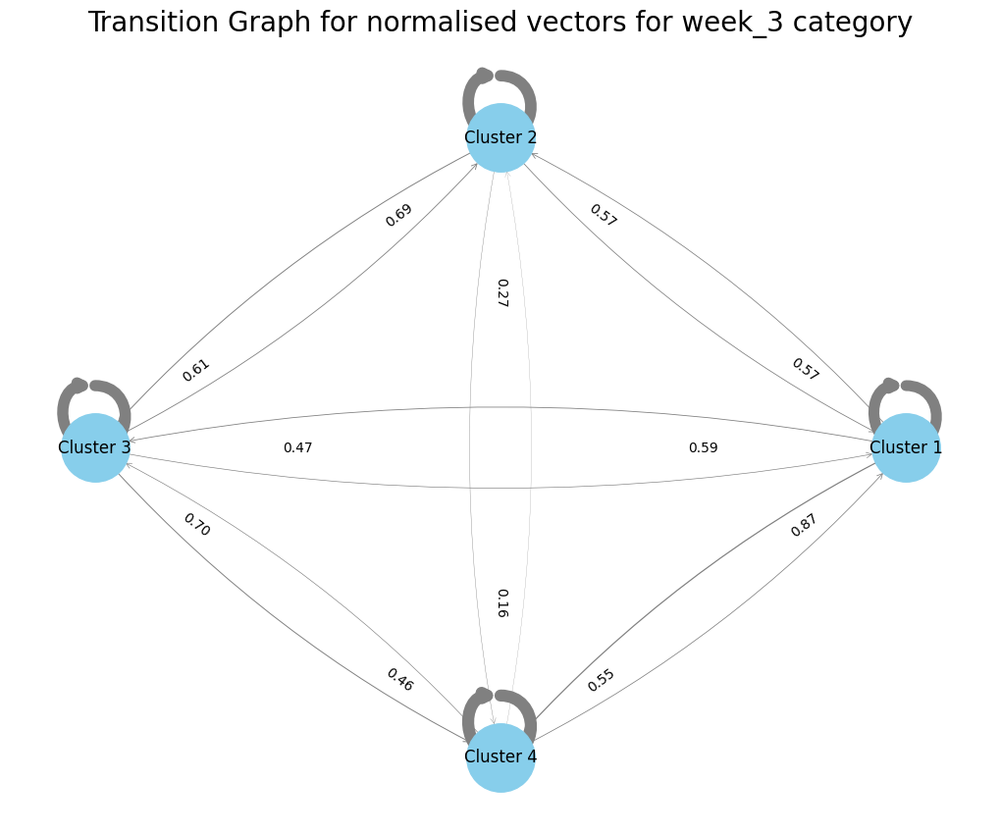

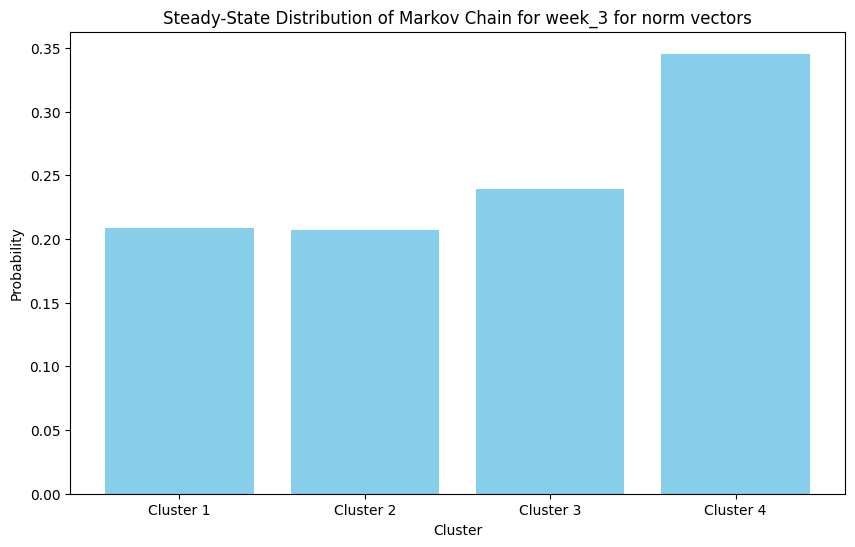

<Figure size 1000x800 with 0 Axes>

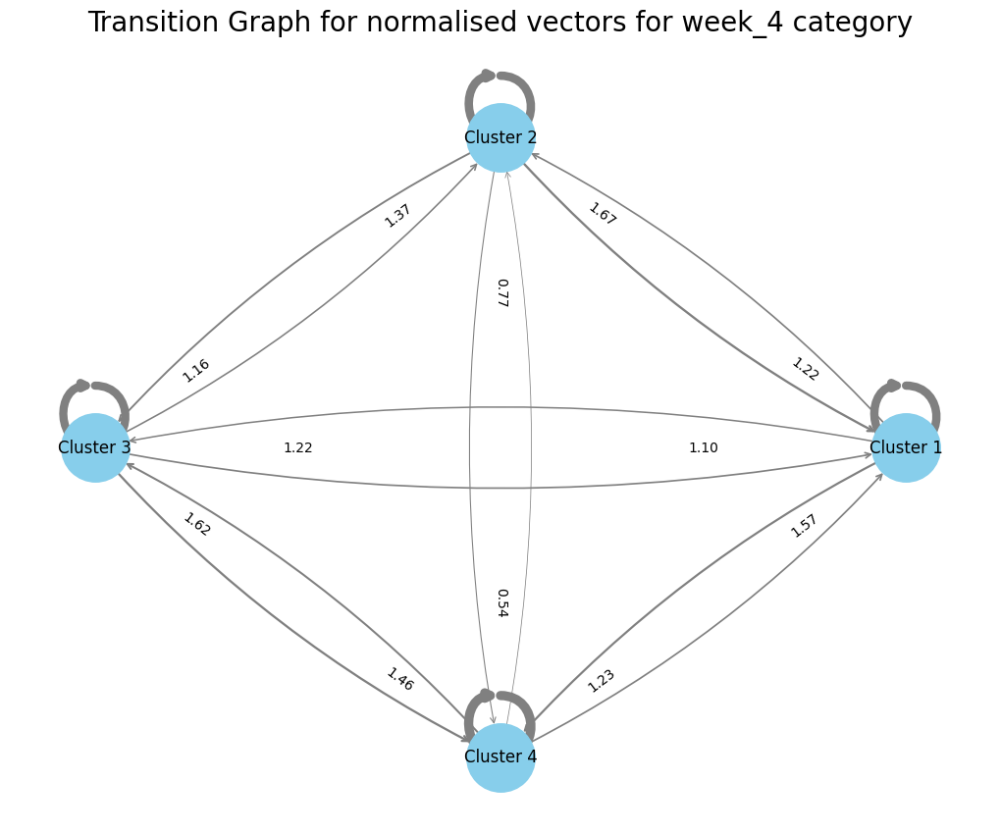

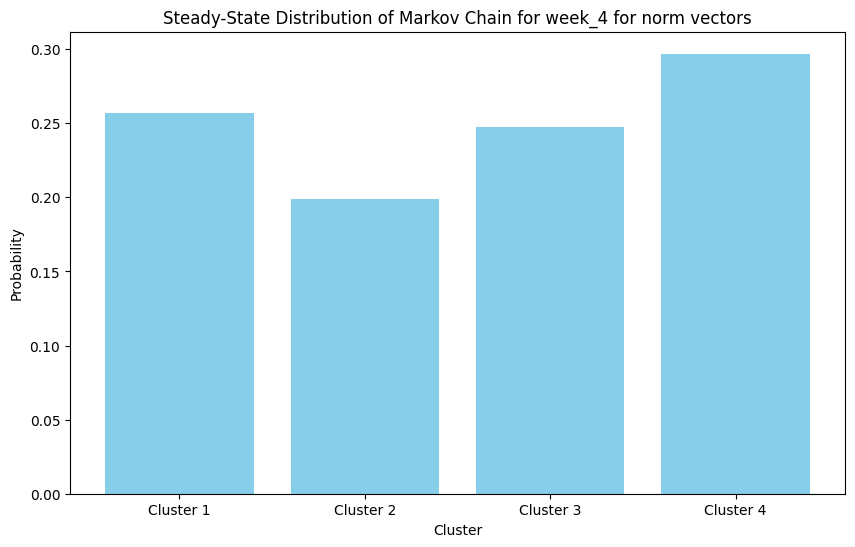

In [83]:
split_dict = {}
transition_matrices_norm_dict= {}
for heading,group in differences_array_norm.groupby([header]):
    split_dict[heading] = group.copy()
for key,value in split_dict.items():
    transitions_norm_key = []
    for i in range(len(value) - 1):
        transitions_norm_key.append((value.iloc[i]['clust'], value.iloc[i+1]['clust']))
        num_clusters = max(value['clust']) + 1 

    transition_matrix_norm_key = np.zeros((num_clusters, num_clusters))

    for (from_cluster, to_cluster) in transitions_norm_key:
        transition_matrix_norm_key[from_cluster, to_cluster] += 1

    transition_matrix_norm_key = transition_matrix_norm_key / transition_matrix_norm_key.sum(axis=1, keepdims=True)
    transition_matrices_norm_dict[key] = transition_matrix_norm_key
    G = nx.DiGraph()

    for i in range(len(transition_matrix_norm_key)):
        for j in range(len(transition_matrix_norm_key[i])):
            prob = transition_matrix_norm_key[i][j]
            if prob > 0:  
                G.add_edge(f'Cluster {i+1}', f'Cluster {j+1}', weight=prob*10) 
    plt.figure(figsize=(10, 8))
    pos = nx.circular_layout(G)  
    edge_weights = nx.get_edge_attributes(G, 'weight')
    edge_widths = [edge_weights[edge] for edge in G.edges()]

    edge_labels = {(u, v): f'{d["weight"]:.2f}' for u, v, d in G.edges(data=True)}
    if isinstance(key, tuple):
        # Join all elements of the tuple into a string separated by spaces, and remove unwanted characters.
        title_str = ' '.join(map(str, key)).replace("'", "").replace(",", "").replace("(", "").replace(")", "")
        
    else:
        # If key is not a tuple, just convert it to a string.
        title_str = str(key)

    plt.figure(figsize=(10, 8))
    nx.draw(G, pos, with_labels=True, node_color='skyblue', node_size=2500, width=edge_widths, arrowstyle='->', connectionstyle='arc3,rad=0.1', edge_color='grey')
 
    nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels, label_pos=0.75, font_size=10)
    safe_key = str(title_str).replace("\\", "").replace("/", "").replace("(", "").replace(")", "").replace(",", "_")
    plt.axis('off')

    plt.title(f'Transition Graph for normalised vectors for {safe_key} category', size=20)
    plt.savefig(f"C:/Users/hugma/diss/data/Transition Graph for normalised vectors for {safe_key} category")
    plt.show()
    
    n = transition_matrix_norm_key.shape[0]
    A = transition_matrix_norm_key.T - np.eye(n)
    A[-1] = np.ones(n)
    b = np.zeros(n)
    b[-1] = 1
    pi = np.linalg.solve(A, b)
    pi
    plt.figure(figsize=(10, 6))
    clusters = [f'Cluster {i+1}' for i in range(n)]

    plt.bar(clusters, pi, color='skyblue')
    plt.xlabel('Cluster')
    plt.ylabel('Probability')
    plt.title(f'Steady-State Distribution of Markov Chain for {safe_key} for norm vectors')
    plt.savefig(f"C:/Users/hugma/diss/data/Steady-State Distribution of Markov Chain for {safe_key} for norm vectors")
    plt.show()
   

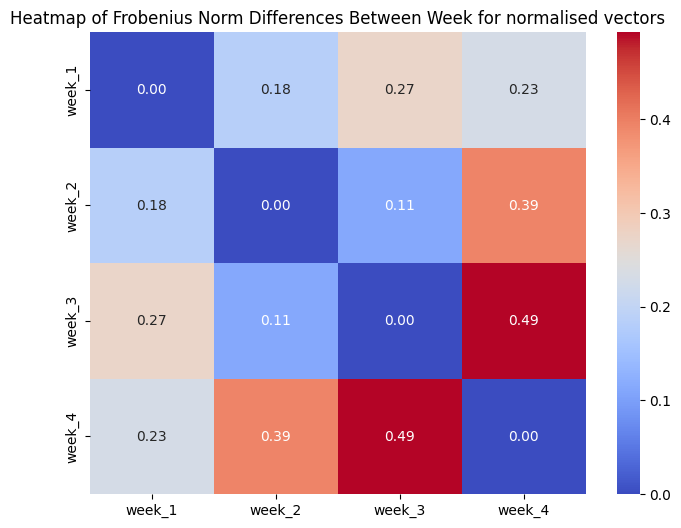

In [84]:
headers = list(transition_matrices_norm_dict.keys())
frobenius_matrix_norm = np.zeros((len(headers), len(headers)))
for i in range(len(headers)):
    for j in range(i + 1, len(headers)):
        diff_norm_matrix = transition_matrices_norm_dict[headers[i]] - transition_matrices_norm_dict[headers[j]]
        frob_norm = np.linalg.norm(diff_norm_matrix, 'fro')
        frobenius_matrix_norm[i, j] = frob_norm
        frobenius_matrix_norm[j, i] = frob_norm 
headers = [str(header).strip("(),'") for header in headers]
plt.figure(figsize=(8, 6))
ax = sns.heatmap(frobenius_matrix_norm, annot=True, fmt=".2f", xticklabels=headers, yticklabels=headers, cmap="coolwarm")
plt.title(f'Heatmap of Frobenius Norm Differences Between {header} for normalised vectors')
plt.savefig(f"C:/Users/hugma/diss/data/Heatmap of Frobenius Norm Differences Between {header} for normalised vectors")
plt.show()


In [85]:
def calculate_nmi_for_labels(df, cluster_assignments_column, labels_of_interest):
    nmi_scores = {}
    for label in labels_of_interest:
        nmi_score = normalized_mutual_info_score(df[cluster_assignments_column], df[label], average_method='arithmetic')
        nmi_scores[label] = nmi_score
    return nmi_scores

In [86]:
def plot_nmi_scores(nmi_scores):
    labels = list(nmi_scores.keys())
    scores = list(nmi_scores.values())
    
    plt.figure(figsize=(10, 6))
    plt.bar(labels, scores, color='skyblue')
    plt.xlabel('Labels')
    plt.ylabel('Normalized Mutual Information Score')
    plt.title('NMI Scores Across Different Labels (Relevancy)')
    plt.xticks(rotation=45)
    plt.tight_layout()
    plt.show()

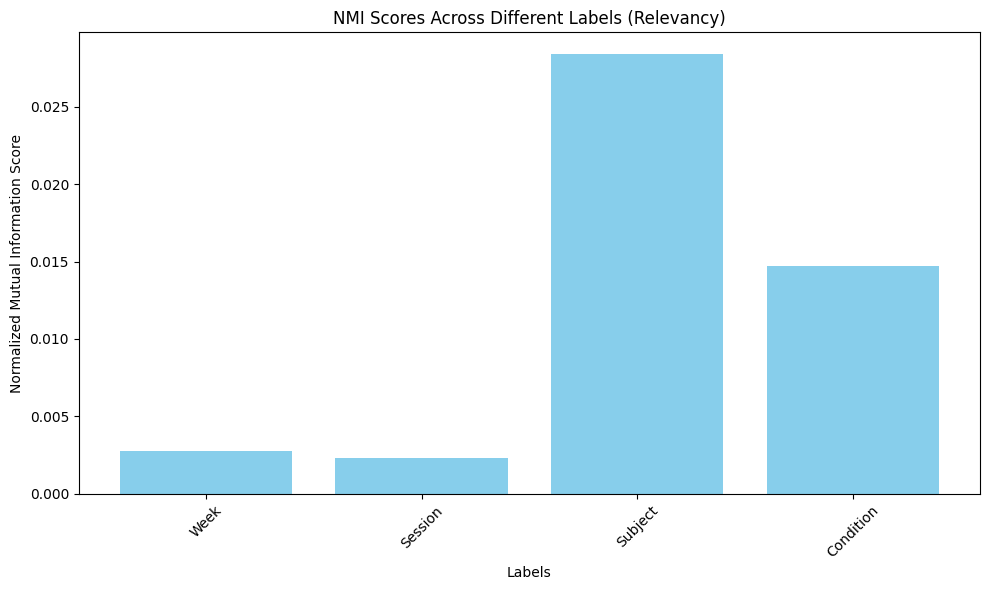

In [87]:
nmi_scores = calculate_nmi_for_labels(differences_array_MI, 'labels normalised vectors', ['Week', 'Session','Subject','Condition'])
plot_nmi_scores(nmi_scores)

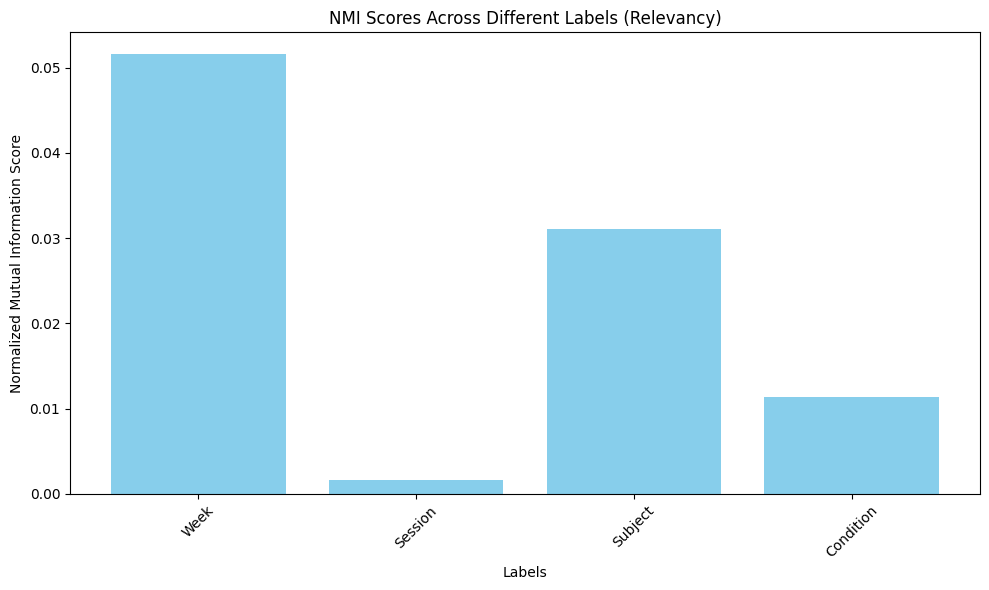

In [88]:
nmi_scores = calculate_nmi_for_labels(differences_array_MI, 'labels unnormalised vectors', ['Week', 'Session','Subject','Condition'])
plot_nmi_scores(nmi_scores)

In [89]:
def calculate_mi_for_combinations(df, labels):
    mi_scores = {}
    for combo in combinations(labels, 2):  # Change 2 to another number for different combination sizes
        label1, label2 = combo
        mi = normalized_mutual_info_score(df[label1], df[label2])
        mi_scores[combo] = mi
    return mi_scores

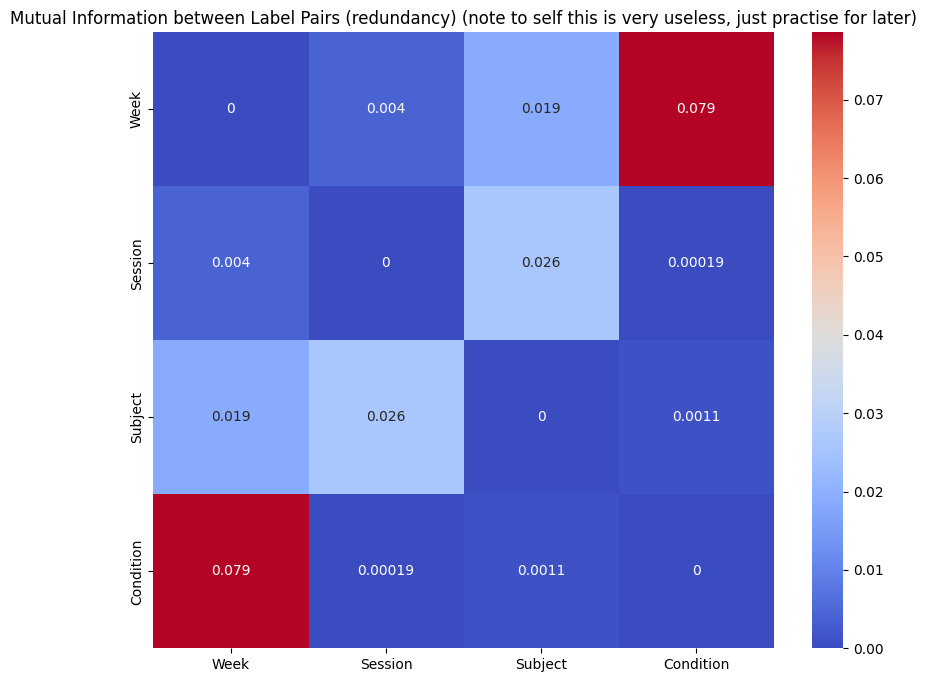

In [90]:
labels_of_interest = ['Week', 'Session','Subject','Condition']
mi_scores = calculate_mi_for_combinations(differences_array_MI, labels_of_interest)


mi_matrix = np.zeros((len(labels_of_interest), len(labels_of_interest)))


for (label1, label2), mi_score in mi_scores.items():
    i, j = labels_of_interest.index(label1), labels_of_interest.index(label2)
    mi_matrix[i, j] = mi_score
    mi_matrix[j, i] = mi_score  
mi_df = pd.DataFrame(mi_matrix, columns=labels_of_interest, index=labels_of_interest)


plt.figure(figsize=(10, 8))
sns.heatmap(mi_df, annot=True, cmap='coolwarm')
plt.title('Mutual Information between Label Pairs (redundancy) (note to self this is very useless, just practise for later)')
plt.show()

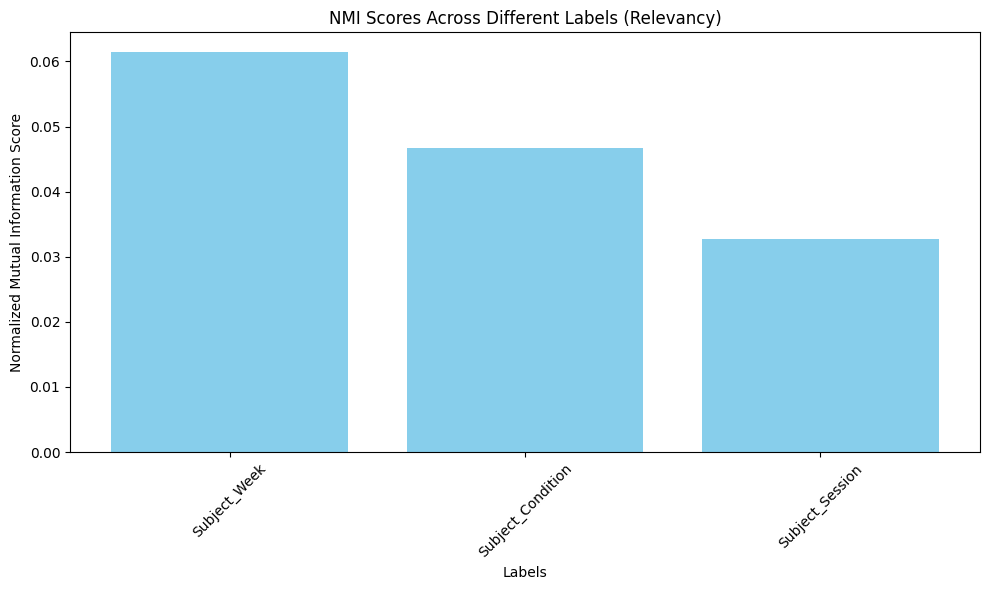

In [91]:
labels_subject = []
for label in ['Week','Condition','Session']:
    differences_array_MI[f'Subject_{label}'] = differences_array_MI['Subject'].astype(str) + '_' + differences_array_MI[label].astype(str)
    labels_subject.append(f'Subject_{label}')
nmi_scores = calculate_nmi_for_labels(differences_array_MI, 'labels unnormalised vectors', labels_subject)
plot_nmi_scores(nmi_scores)


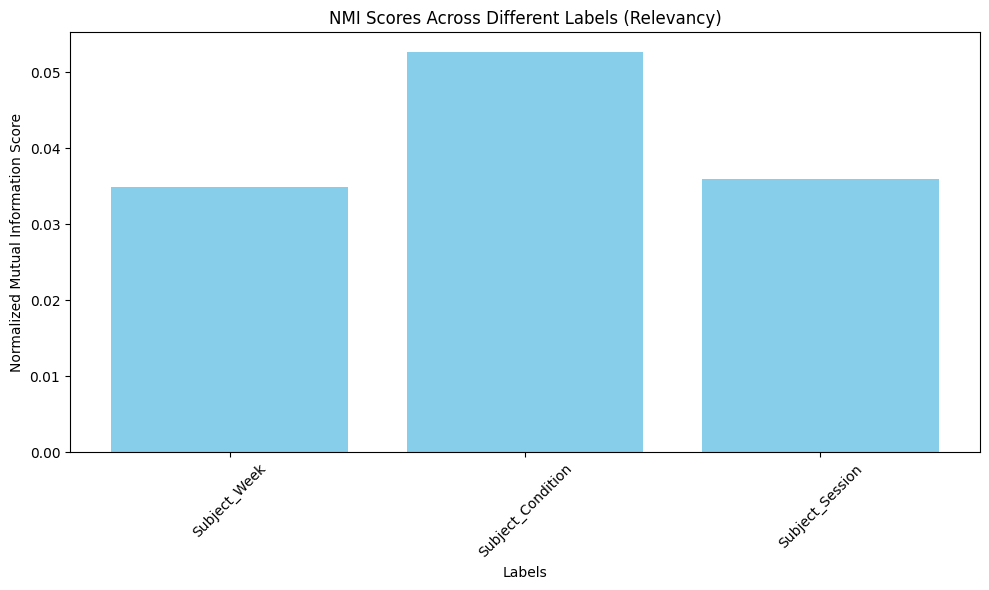

In [92]:
nmi_scores = calculate_nmi_for_labels(differences_array_MI, 'labels normalised vectors', labels_subject)
plot_nmi_scores(nmi_scores)

C:\Users\hugma\AppData\Local\Temp\ipykernel_19420\3036985243.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure()


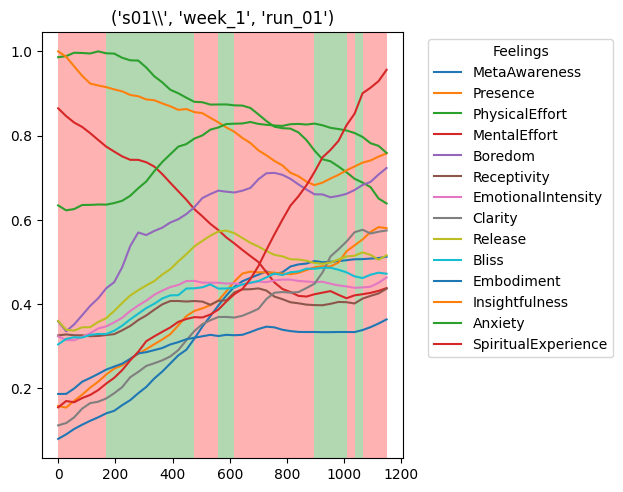

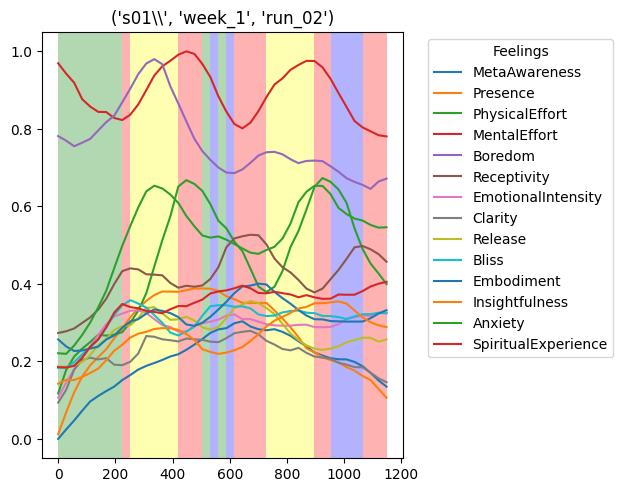

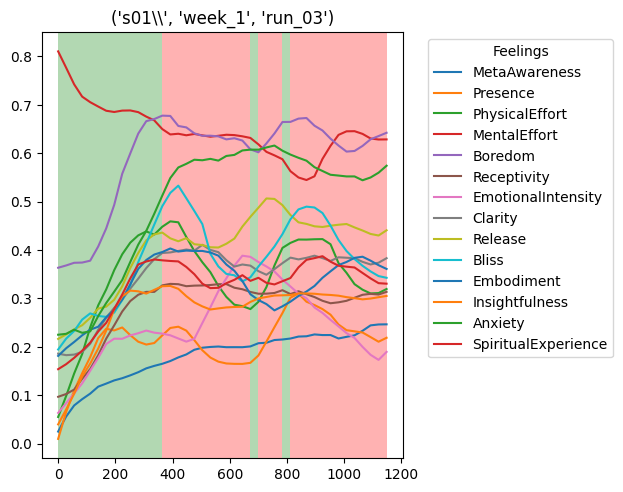

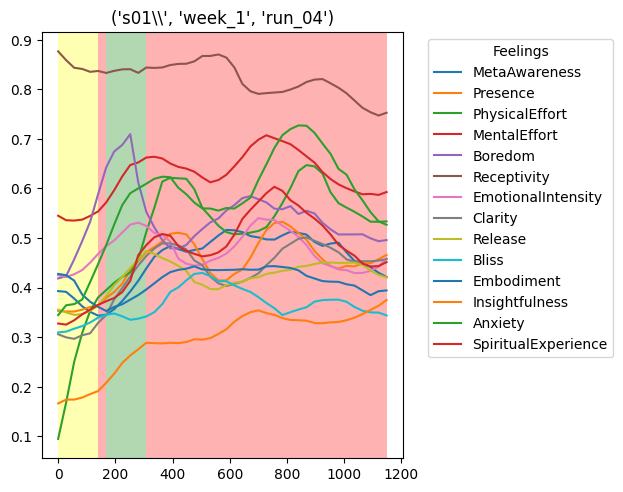

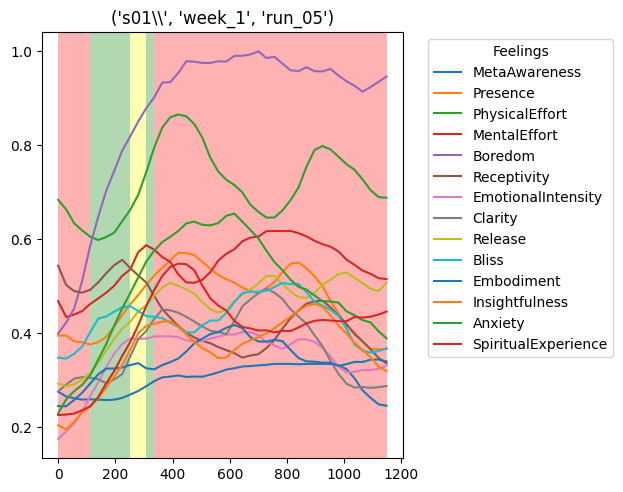

...

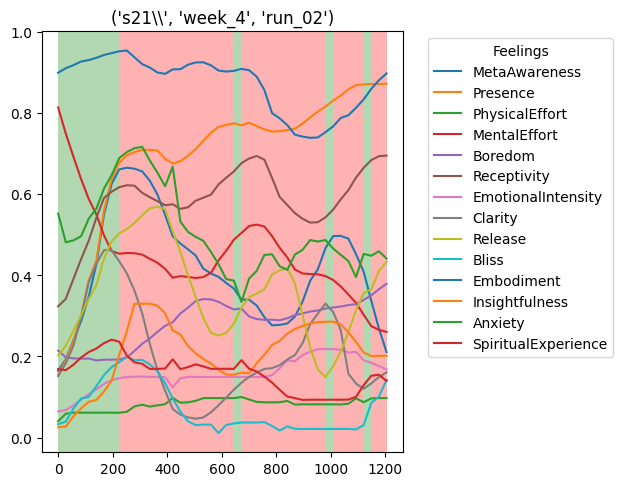

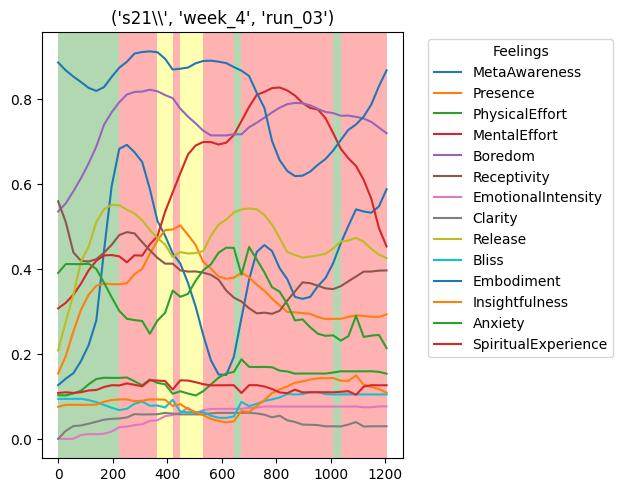

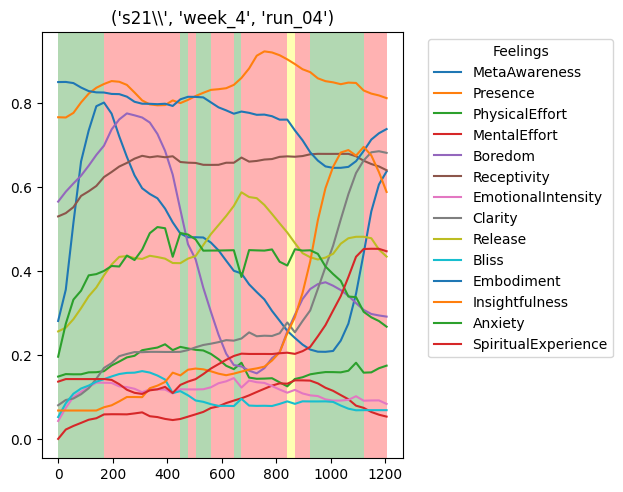

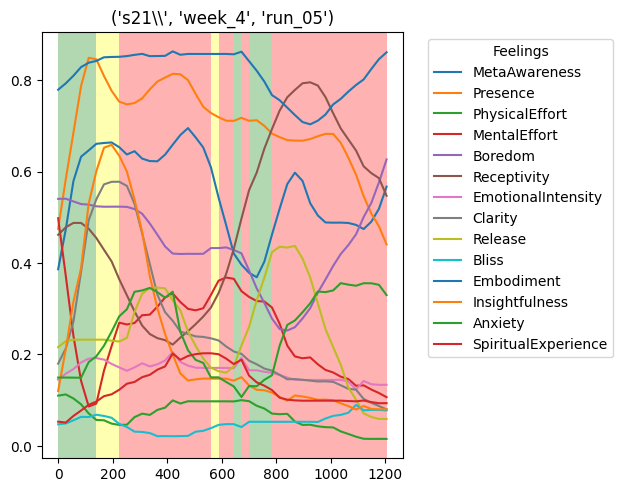

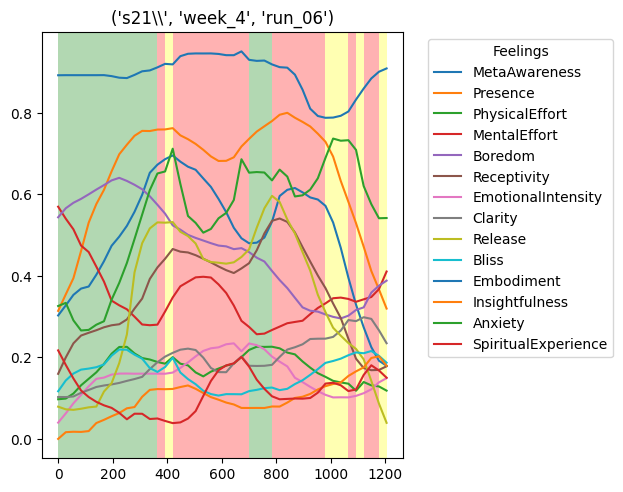

In [93]:
cluster_centres_prin_norm = np.transpose(cluster_centres_norm.dot(principal_components),(1,0))
differences_array[["principal componant 1 non-diff", "principal componant 2 non-diff"]] = differences_array[feelings].dot(principal_components)
traj_transitions_dict = {}
color_map = {
    0: 'red',
    1: 'green',
    2: 'blue',
    3: 'yellow'
}
for heading,group in differences_array.groupby(['Subject','Week','Session']):
    traj_transitions_dict[heading] = group

for heading,value in traj_transitions_dict.items():
    plt.figure()
    for feeling in feelings:
        starting_time = 0 
        time_jump = 28 
        time_array = np.arange(starting_time, starting_time + time_jump * value.shape[0], time_jump)
        plt.plot(time_array,value[feeling],label=feeling)
    plt.legend(title='Feelings', bbox_to_anchor=(1.05, 1), loc='upper left')  # Add a legend with a title
    plt.tight_layout() 
    plt.title(heading)
    prev_color_val = value['clust'].iloc[0]
    start_index = 0
    for index, color_val in enumerate(value['clust']):
        if color_val != prev_color_val or index == value.shape[0] - 1:
            # Only go up to the previous index if it's not the last span
            end_index = index*time_jump if index != value.shape[0] - 1 else time_array[-1]
            plt.axvspan(start_index*time_jump, end_index, facecolor=color_map[prev_color_val], alpha=0.3)
            start_index = index
            prev_color_val = color_val

In [94]:
traj_transitions_dict['s01\\', 'week_1', 'run_01']['clust']

0     0
1     0
2     0
3     0
4     0
5     0
6     1
7     1
8     1
9     1
10    1
11    1
12    1
13    1
14    1
15    1
16    1
17    0
18    0
19    0
20    1
21    1
22    0
23    0
24    0
25    0
26    0
27    0
28    0
29    0
30    0
31    0
32    1
33    1
34    1
35    1
36    0
37    1
38    0
39    0
40    0
41    0
Name: clust, dtype: int32

: 